<a href="https://colab.research.google.com/github/MikaTan2007/Algoverse/blob/main/notebooks/pixart-sigma/base/linear_probe/LinearProbe_PixartSigma.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Project Setup

### Install Libs

In [ ]:
from google.colab import drive
drive.mount('/content/drive')
%pip install -U diffusers  # ensure it's >= 0.28.0
%pip install transformers accelerate safetensors sentencepiece
%pip install ftfy
%pip install h5py

import torch
from diffusers import PixArtSigmaPipeline
import numpy as np
import matplotlib.pyplot as plt
from collections import defaultdict



import pandas as pd

drive_path = "/content/drive/MyDrive/Algoverse/Linear_Probe_Data/Prompts"
csv_file_path = f"{drive_path}/cf10_prompts.csv"

try:
    prompts_df = pd.read_csv(csv_file_path)
    print("CSV file loaded successfully.")
    #display(prompts_df.head())
except FileNotFoundError:
    print(f"Error: The file '{csv_file_path}' was not found.")
except Exception as e:
    print(f"An error occurred while loading the CSV file: {e}")

Mounted at /content/drive
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 4.1/4.1 MB 25.0 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 44.8/44.8 kB 2.7 MB/s eta 0:00:00


/usr/local/lib/python3.12/dist-packages/torch_xla/experimental/gru.py:113: SyntaxWarning: invalid escape sequence '\_'
  * **h_n**: tensor of shape :math:`(D * \text{num\_layers}, H_{out})` or
/usr/local/lib/python3.12/dist-packages/jax/_src/cloud_tpu_init.py:82: UserWarning: Transparent hugepages are not enabled. TPU runtime startup and shutdown time should be significantly improved on TPU v5e and newer. If not already set, you may need to enable transparent hugepages in your VM image (sudo sh -c "echo always > /sys/kernel/mm/transparent_hugepage/enabled")
  warnings.warn(


CSV file loaded successfully.


### Pipe

In [ ]:
def get_device():
  if torch.cuda.is_available():
    return "cuda"
  elif torch.backends.mps.is_available():
    return "mps"
  else:
    return "cpu"

device = get_device()

weight_dtype = torch.float16

pipe = PixArtSigmaPipeline.from_pretrained(
    "PixArt-alpha/PixArt-Sigma-XL-2-1024-MS",
    torch_dtype=weight_dtype,
    use_safetensors=True,
)
pipe.to(device)

/usr/local/lib/python3.12/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


model_index.json:   0%|          | 0.00/400 [00:00<?, ?B/s]

Fetching 13 files:   0%|          | 0/13 [00:00<?, ?it/s]

config.json:   0%|          | 0.00/747 [00:00<?, ?B/s]

model.safetensors.index.json: 0.00B [00:00, ?B/s]

special_tokens_map.json: 0.00B [00:00, ?B/s]

tokenizer_config.json: 0.00B [00:00, ?B/s]

text_encoder/model-00001-of-00002.safete(…):   0%|          | 0.00/9.99G [00:00<?, ?B/s]

scheduler_config.json:   0%|          | 0.00/655 [00:00<?, ?B/s]

text_encoder/model-00002-of-00002.safete(…):   0%|          | 0.00/9.06G [00:00<?, ?B/s]

config.json:   0%|          | 0.00/785 [00:00<?, ?B/s]

config.json:   0%|          | 0.00/631 [00:00<?, ?B/s]

transformer/diffusion_pytorch_model.safe(…):   0%|          | 0.00/2.44G [00:00<?, ?B/s]

vae/diffusion_pytorch_model.safetensors:   0%|          | 0.00/335M [00:00<?, ?B/s]

tokenizer/spiece.model:   0%|          | 0.00/792k [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/5 [00:00<?, ?it/s]

`torch_dtype` is deprecated! Use `dtype` instead!


Loading checkpoint shards:   0%|          | 0/2 [00:00<?, ?it/s]

You are using the default legacy behaviour of the <class 'transformers.models.t5.tokenization_t5.T5Tokenizer'>. This is expected, and simply means that the `legacy` (previous) behavior will be used so nothing changes for you. If you want to use the new behaviour, set `legacy=False`. This should only be set if you understand what it means, and thoroughly read the reason why this was added as explained in https://github.com/huggingface/transformers/pull/24565


PixArtSigmaPipeline {
  "_class_name": "PixArtSigmaPipeline",
  "_diffusers_version": "0.35.1",
  "_name_or_path": "PixArt-alpha/PixArt-Sigma-XL-2-1024-MS",
  "scheduler": [
    "diffusers",
    "DPMSolverMultistepScheduler"
  ],
  "text_encoder": [
    "transformers",
    "T5EncoderModel"
  ],
  "tokenizer": [
    "transformers",
    "T5Tokenizer"
  ],
  "transformer": [
    "diffusers",
    "PixArtTransformer2DModel"
  ],
  "vae": [
    "diffusers",
    "AutoencoderKL"
  ]
}

## Collecting Activations
Layers 13-20

#### Prompts

In [ ]:
prompt = prompts_df.iloc[0]["airplane"]
prompt

'An aerial view showing a airplane in formation over the ocean, in a city, docked, during golden hour'

#### Functions Needed

In [ ]:
import torch
from contextlib import contextmanager
from collections import defaultdict
from tqdm.auto import tqdm
from typing import List, Dict, Generator

# --------------------------------------------------------------------------
# 1. The Functional Context Manager for Collecting Activations
# --------------------------------------------------------------------------

@contextmanager
def collect_activations(model: torch.nn.Module, layer_names: List[str]) -> Generator[Dict[str, List[torch.Tensor]], None, None]:
    """
    A function-based context manager to collect activations from specified layers.
    """
    activations = defaultdict(list)
    hooks = []

    def _create_hook(layer_name: str):
        """Creates a hook function that appends the output to our list."""
        def hook(module, input, output):
            tensor_output = output[0] if isinstance(output, tuple) else output
            activations[layer_name].append(tensor_output.detach().cpu())
        return hook

    try:
        for name, module in model.named_modules():
            if name in layer_names:
                hook_handle = module.register_forward_hook(_create_hook(name))
                hooks.append(hook_handle)
        yield activations
    finally:
        for hook in hooks:
            hook.remove()

# --------------------------------------------------------------------------
# 2. Main Function to Run the Experiment (with fix)
# --------------------------------------------------------------------------

def run_and_collect(pipe: PixArtSigmaPipeline, prompt: str, layer_names: List[str], num_inference_steps: int = 10) -> Dict[str, Dict[int, torch.Tensor]]:
    """
    Runs a single diffusion generation and collects activations from specified
    layers at each timestep.
    """
    device = pipe.device

    # Setup for the diffusion loop
    prompt_embeds, _, _, _ = pipe.encode_prompt(prompt=prompt, device=device)
    generator = torch.Generator(device=device).manual_seed(42)

    latents = pipe.prepare_latents(
        batch_size=1,
        num_channels_latents=pipe.transformer.config.in_channels,
        height=1024, width=1024,
        dtype=prompt_embeds.dtype, device=device,
        generator=generator
    )
    pipe.scheduler.set_timesteps(num_inference_steps, device=device)
    timesteps = pipe.scheduler.timesteps

    # Run loop inside the context manager
    with collect_activations(pipe.transformer, layer_names) as temp_activations:
        print("Running custom diffusion loop with hooks...")
        # FIX 1: Wrap the inference loop in torch.no_grad() to save memory
        with torch.no_grad():
            for t in tqdm(timesteps):
                noise_pred_8_channel = pipe.transformer(
                    hidden_states=latents,
                    encoder_hidden_states=prompt_embeds,
                    timestep=t.unsqueeze(0),
                ).sample

                noise_pred = noise_pred_8_channel.chunk(2, dim=1)[0]
                latents = pipe.scheduler.step(noise_pred, t, latents).prev_sample

    # Post-process to map timesteps to activations
    final_activations = defaultdict(dict)
    for layer_name, activation_list in temp_activations.items():
        for i, t in enumerate(timesteps):
            final_activations[layer_name][t.item()] = activation_list[i]

    return final_activations

# FIX 2: Enable attention slicing for additional memory savings
pipe.enable_attention_slicing()

In [ ]:
all_activations

#### Plotting Activations

Calculating global activation value range...
Global activation range (1st to 99th percentile): -3.70 to 4.18


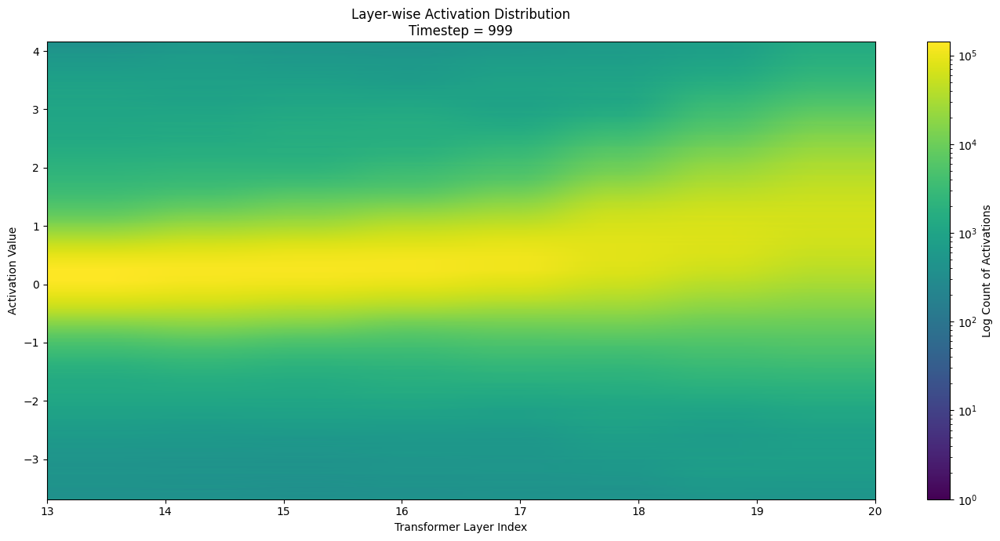

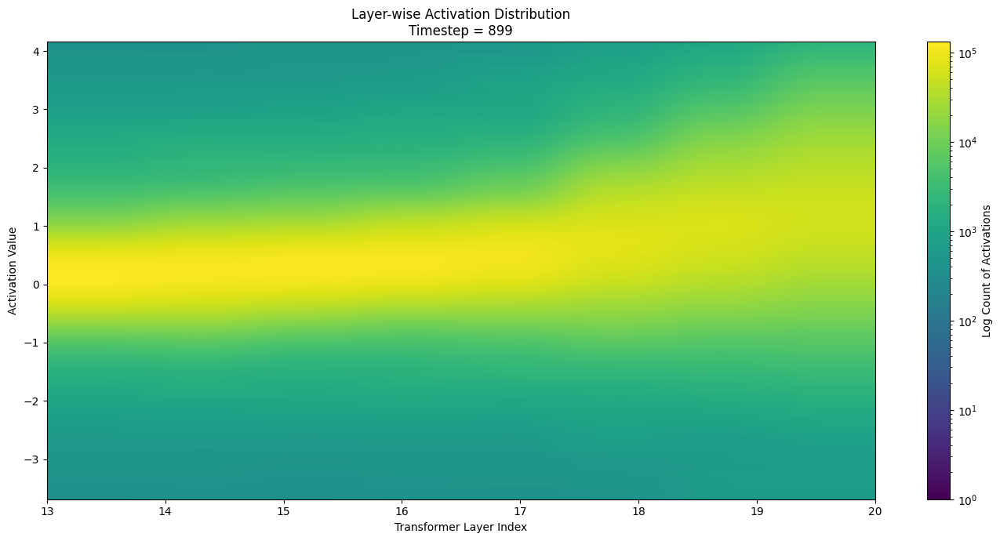

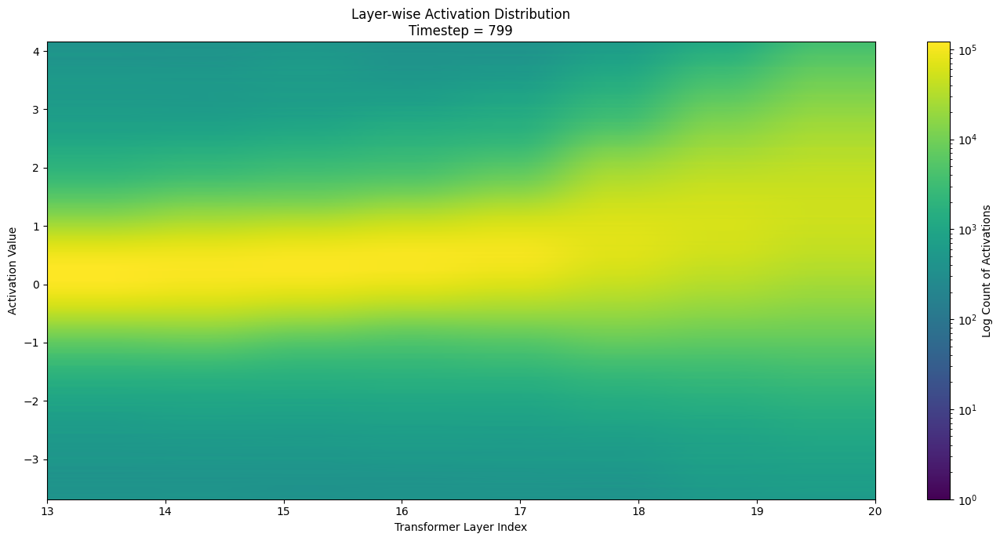

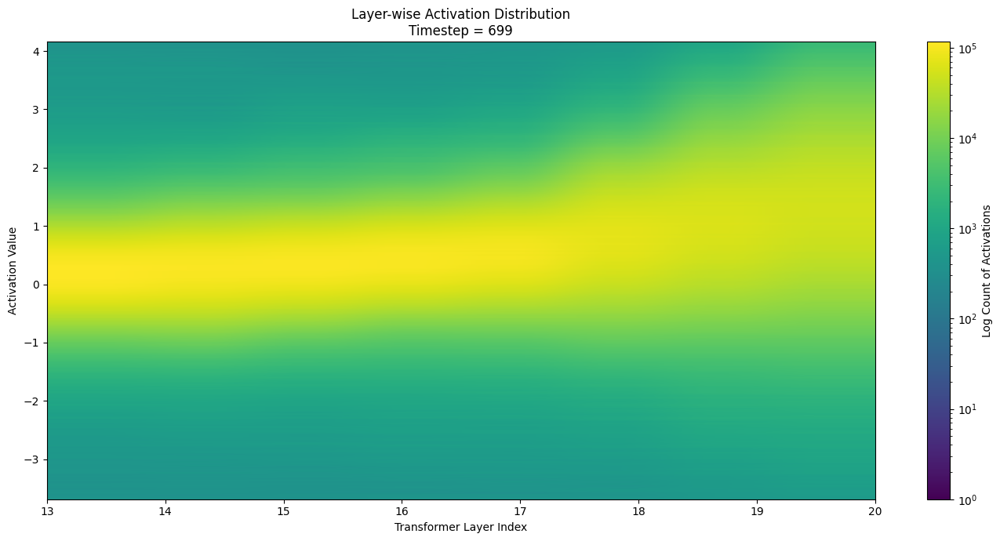

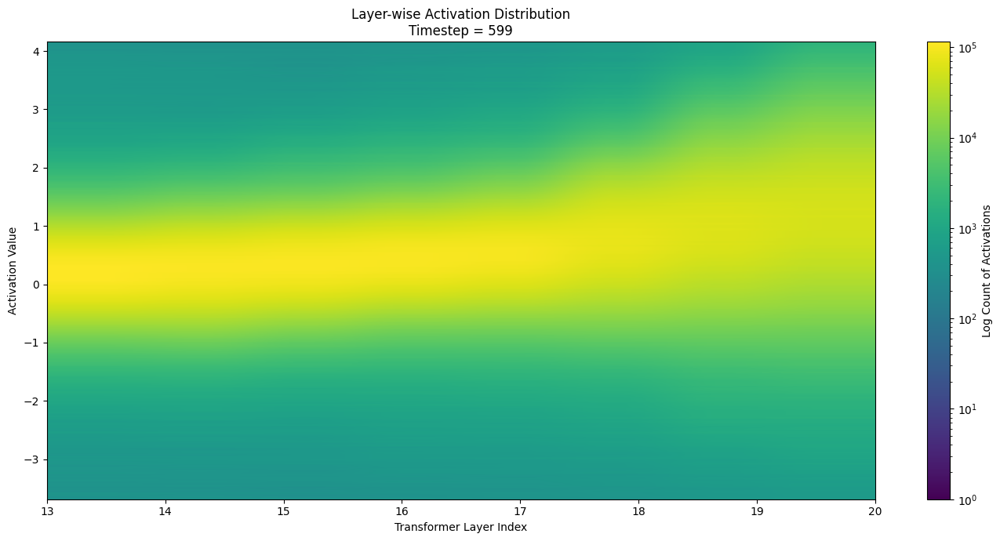

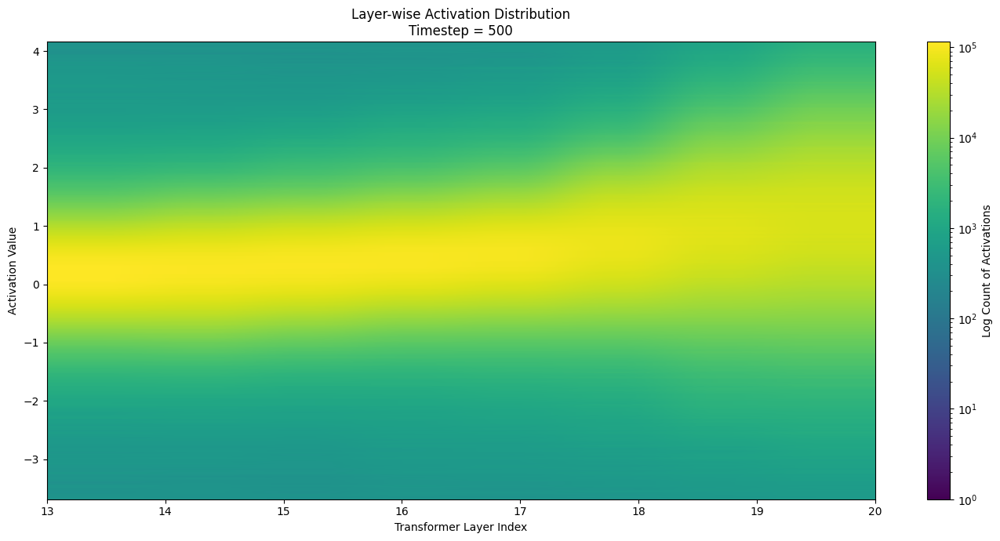

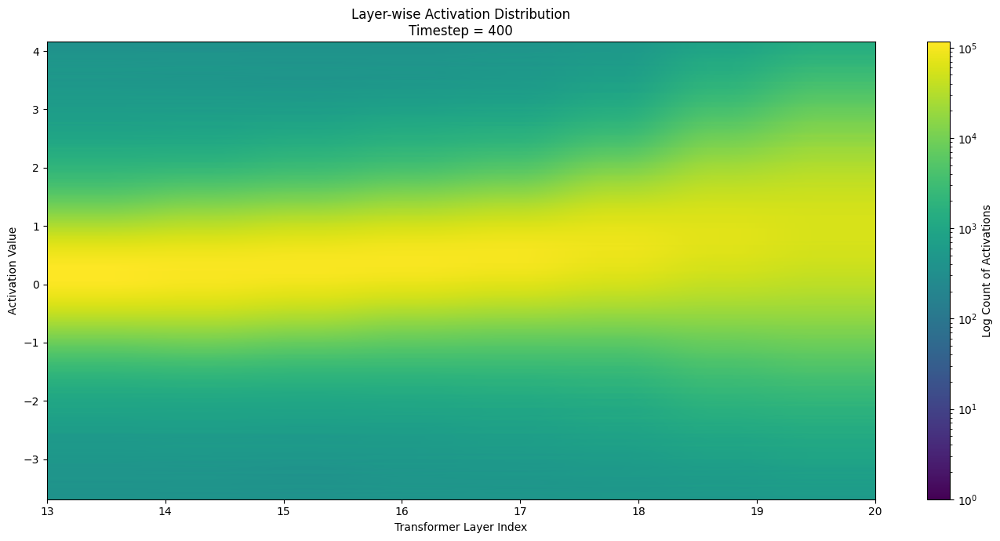

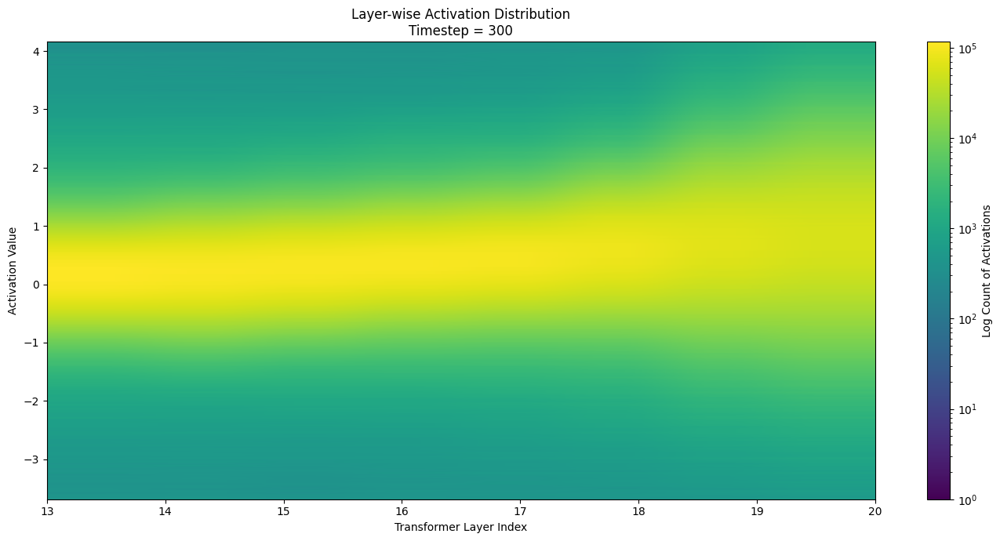

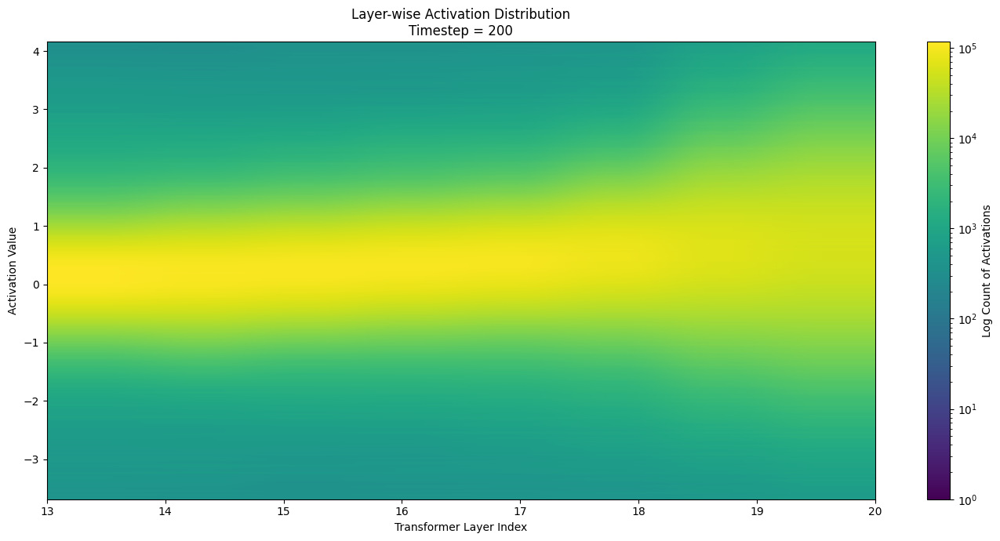

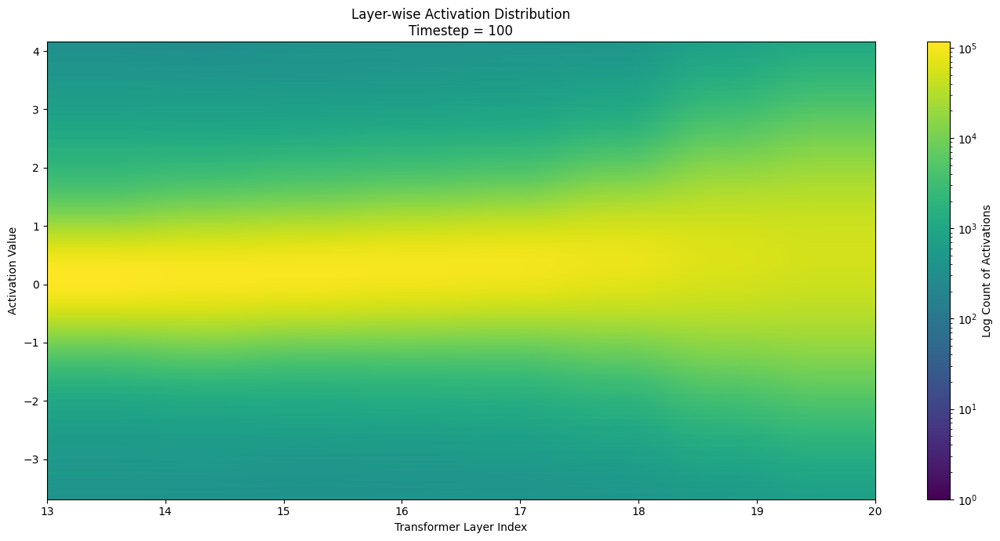

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import LogNorm
import torch

def plot_layerwise_activation_distribution(all_activations: dict, bins: int = 250, title: str = "Layer-wise Activation Distribution"):
    """
    Plots the distribution of raw activation values for each layer as a heatmap for each timestep.

    This helps visualize if data from all layers and timesteps has been captured and shows
    how the scale and spread of activations change.

    Args:
        all_activations (dict): A nested dictionary with the structure {layer_name: {timestep: tensor}}.
                                The tensor shape is (batch, tokens, features).
        bins (int): The number of bins to use for the histogram.
        title (str): The main title for the plots.
    """
    if not all_activations:
        print("The 'all_activations' dictionary is empty. No data to plot.")
        return

    # --- 1. Flatten all activation values to compute a consistent range for the bins ---
    print("Calculating global activation value range...")
    all_values = []
    # Sort layers numerically by their index (e.g., 'transformer_blocks.12')
    sorted_layer_names = sorted(all_activations.keys(), key=lambda name: int(name.split('.')[-1]))

    for layer_name in sorted_layer_names:
        for timestep in all_activations[layer_name]:
            # Flatten the tensor and convert to numpy
            all_values.append(all_activations[layer_name][timestep].numpy().flatten())

    # Concatenate into a single large array
    if all_values:
        all_values = np.concatenate(all_values)
    else:
        print("No activation tensors found in the dictionary.")
        return

    # Define the histogram bins based on the global min/max
    vmin, vmax = np.percentile(all_values, [1, 99]) # Use percentiles to avoid extreme outliers
    bin_edges = np.linspace(vmin, vmax, bins + 1)
    bin_centers = 0.5 * (bin_edges[:-1] + bin_edges[1:])
    print(f"Global activation range (1st to 99th percentile): {vmin:.2f} to {vmax:.2f}")

    # --- 2. Create a plot for each timestep ---
    # Get a sorted list of all unique timesteps
    timesteps = sorted(list(next(iter(all_activations.values())).keys()), reverse=True)

    for t in timesteps:
        # Create a matrix to hold histogram counts: (bins, layers)
        heatmap_matrix = np.zeros((bins, len(sorted_layer_names)))

        for j, layer_name in enumerate(sorted_layer_names):
            if t in all_activations[layer_name] and all_activations[layer_name][t].numel() > 0:
                # Get the activations for the current layer and timestep
                activations_tensor = all_activations[layer_name][t]

                # Calculate the histogram for this layer's activations
                counts, _ = np.histogram(activations_tensor.numpy(), bins=bin_edges)
                heatmap_matrix[:, j] = counts

        # --- 3. Plot the heatmap ---
        plt.figure(figsize=(14, 7))
        # Use LogNorm to better visualize counts that vary by orders of magnitude
        # vmin=1 ensures that bins with zero count are not colored
        plt.imshow(
            heatmap_matrix,
            aspect="auto",
            origin="lower",
            extent=[0, len(sorted_layer_names) - 1, bin_centers[0], bin_centers[-1]],
            norm=LogNorm(vmin=1, vmax=max(heatmap_matrix.max(), 1.0)),
            cmap="viridis"
        )

        plt.colorbar(label="Log Count of Activations")

        # Configure ticks to show the actual layer index
        tick_indices = np.arange(len(sorted_layer_names))
        tick_labels = [name.split('.')[-1] for name in sorted_layer_names]
        plt.xticks(ticks=tick_indices, labels=tick_labels)

        plt.xlabel("Transformer Layer Index")
        plt.ylabel("Activation Value")
        plt.title(f"{title}\nTimestep = {t}")
        plt.tight_layout()
        plt.show()

if __name__ == '__main__':
    plot_layerwise_activation_distribution(all_activations)

Calculating L2 norms for all activations...
Calculating global norm value range...
Global norm range: 44.62 to 1062.89


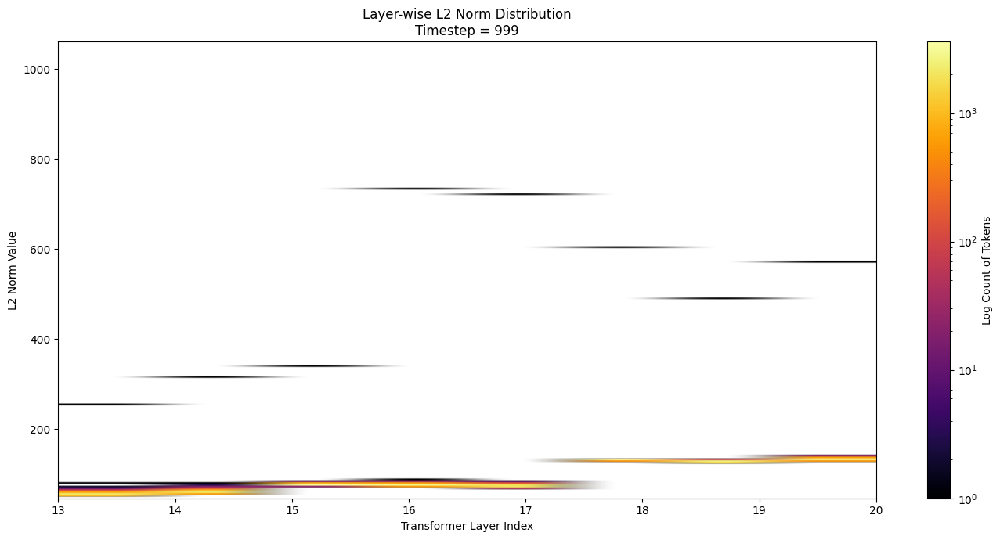

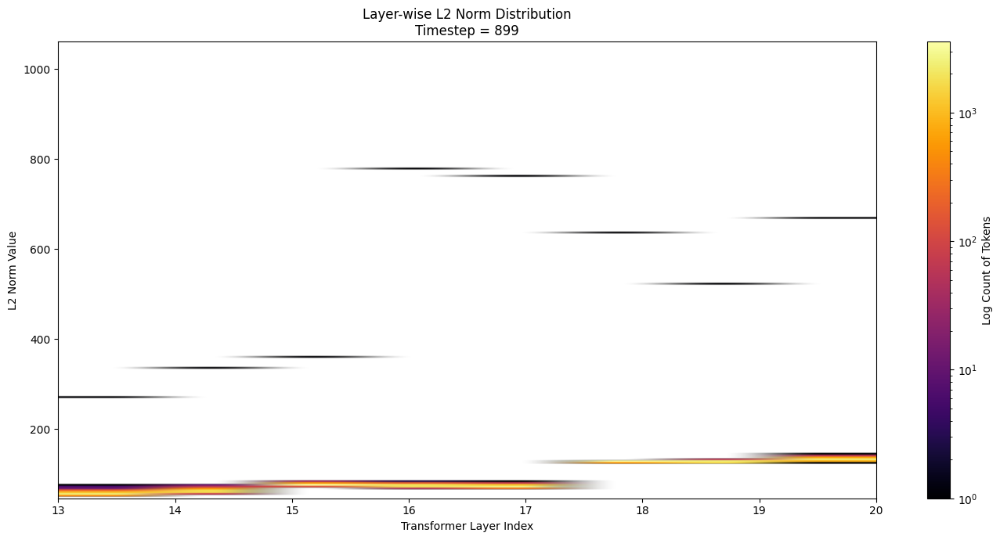

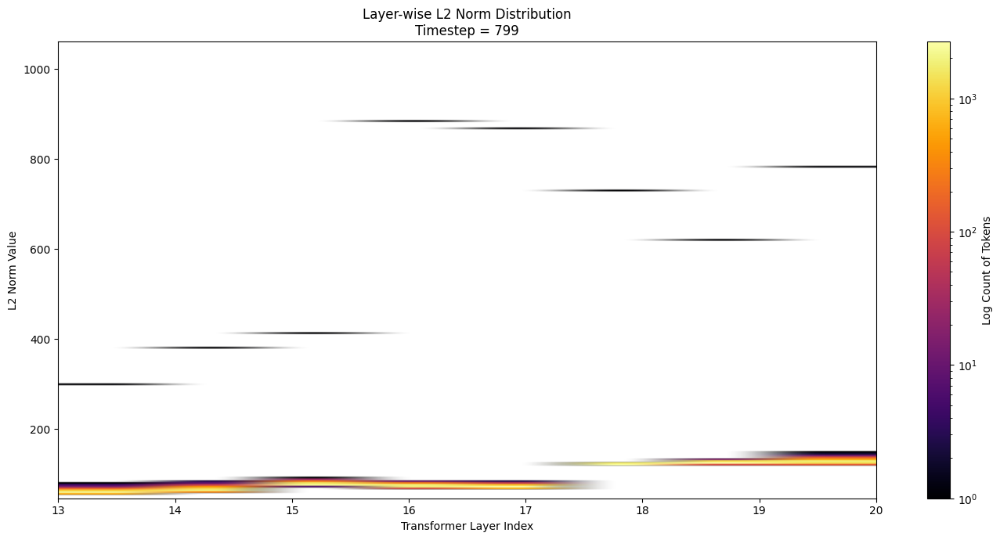

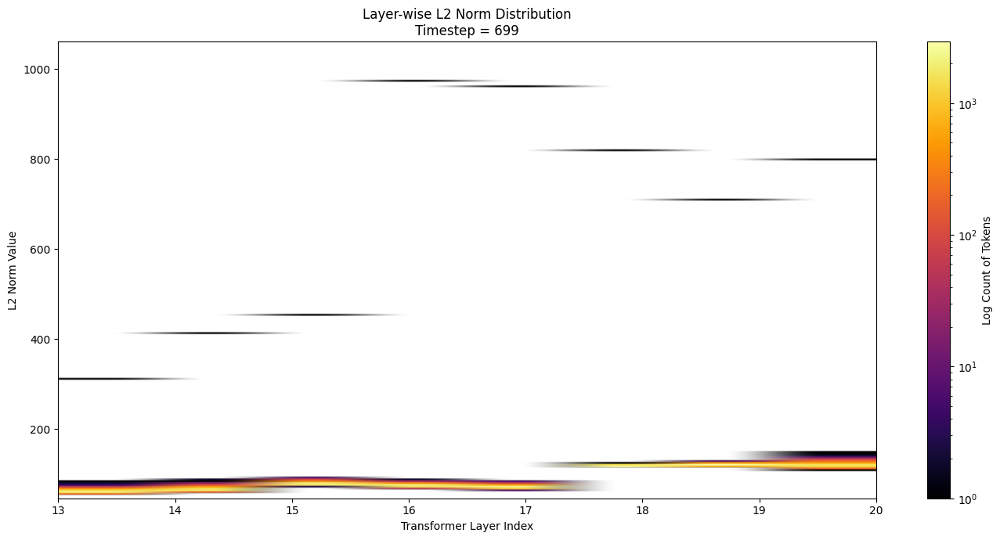

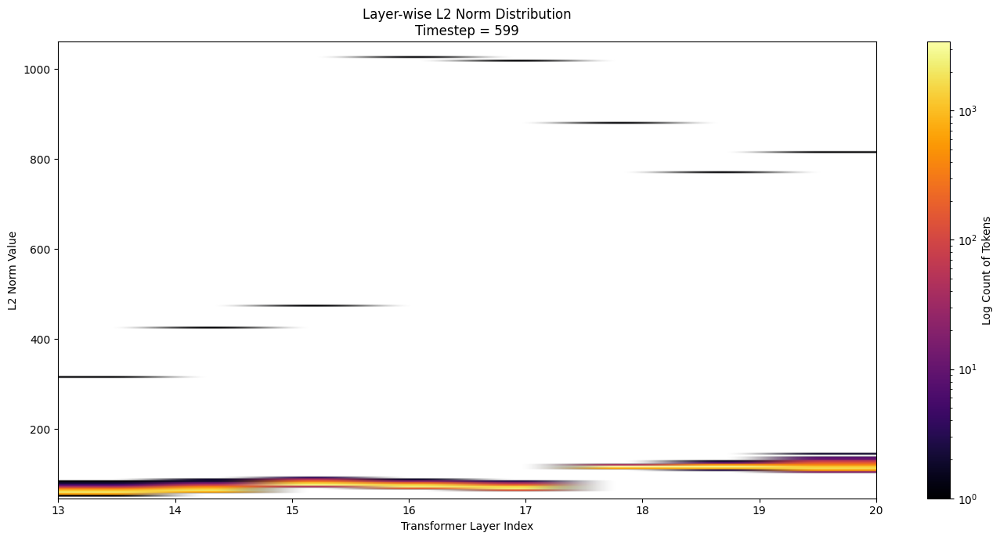

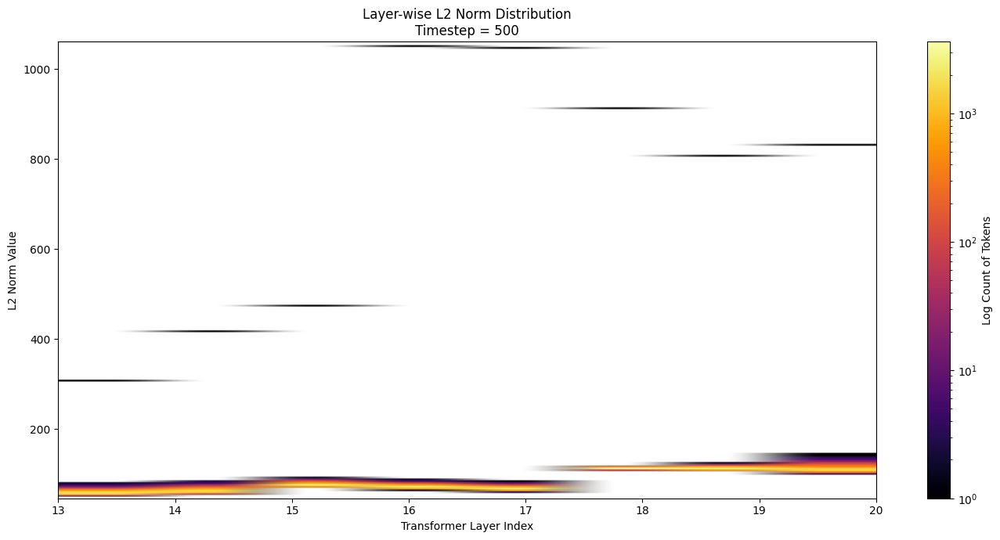

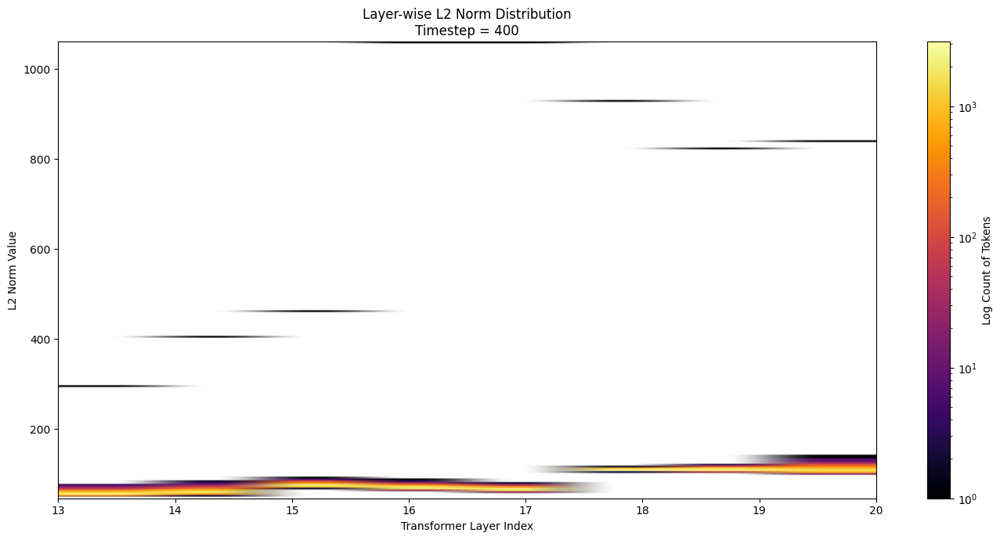

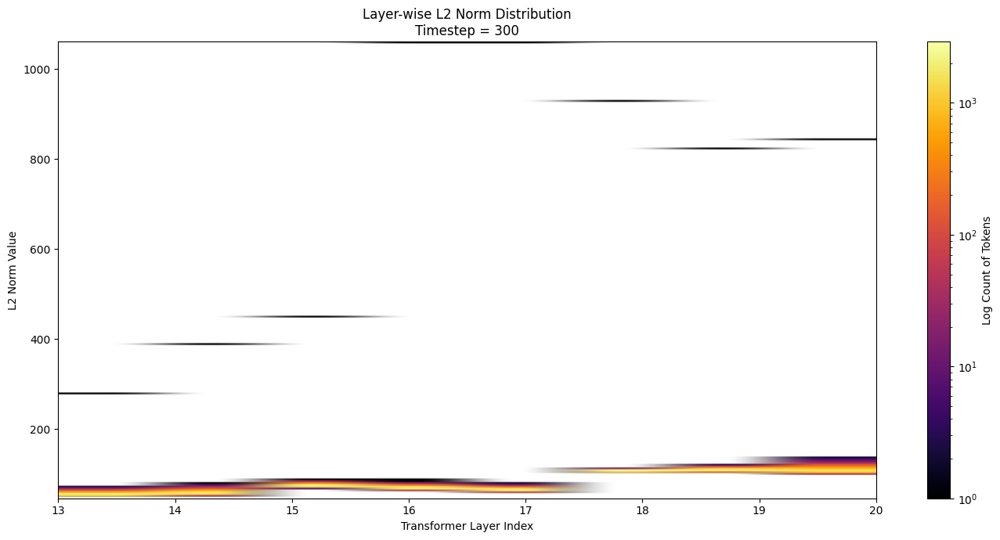

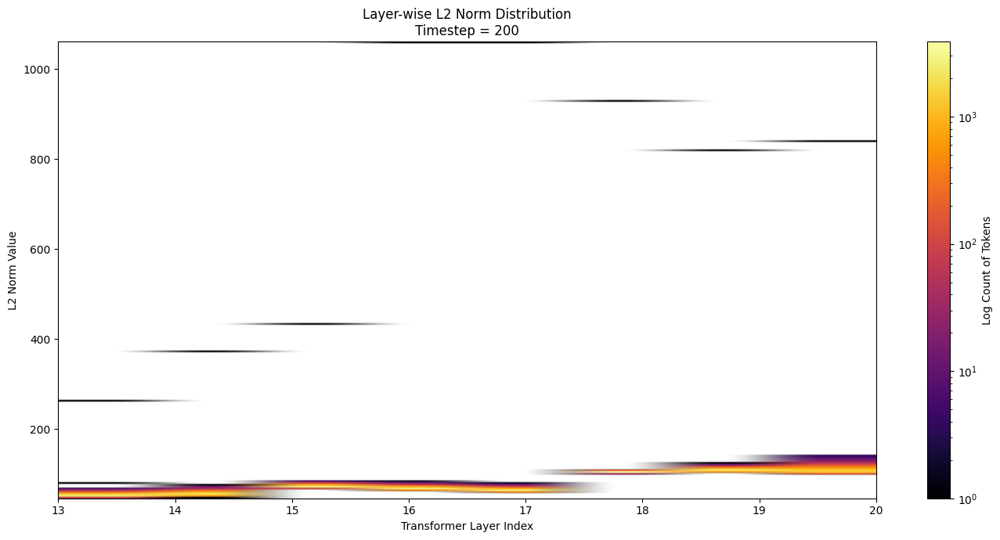

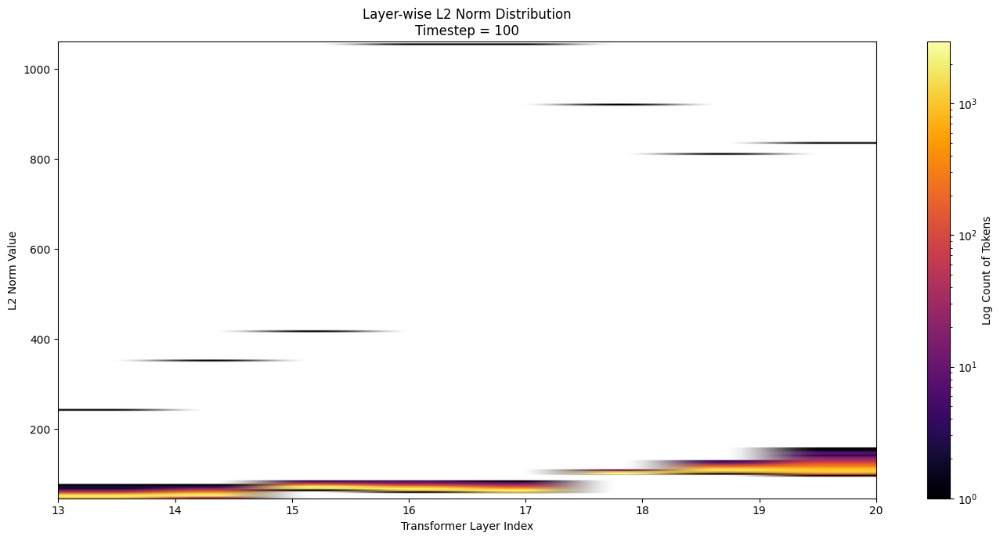

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import LogNorm
import torch

def plot_layerwise_norm_distribution(all_activations: dict, bins: int = 250, title: str = "Layer-wise L2 Norm Distribution"):
    """
    Calculates the L2 norm for each token's activation vector and plots the distribution
    of these norms for each layer as a heatmap for each timestep.

    Args:
        all_activations (dict): A nested dictionary with the structure {layer_name: {timestep: tensor}}.
                                The tensor shape is (batch, tokens, features).
        bins (int): The number of bins to use for the histogram.
        title (str): The main title for the plots.
    """
    if not all_activations:
        print("The 'all_activations' dictionary is empty. No data to plot.")
        return

    # --- 1. First, calculate the L2 norm for each token's activation vector ---
    print("Calculating L2 norms for all activations...")
    layer_norms = {}
    sorted_layer_names = sorted(all_activations.keys(), key=lambda name: int(name.split('.')[-1]))

    for layer_name in sorted_layer_names:
        layer_norms[layer_name] = {}
        for timestep, tensor in all_activations[layer_name].items():
            # Ensure tensor is float32 for stable norm calculation
            activations_float32 = tensor.to(torch.float32)
            # Calculate L2 norm along the last dimension (the feature dimension)
            norms = torch.linalg.norm(activations_float32, ord=2, dim=-1)
            layer_norms[layer_name][timestep] = norms

    # --- 2. Flatten all norms to compute a consistent range for the bins ---
    print("Calculating global norm value range...")
    all_values = []
    for layer_name in sorted_layer_names:
        for timestep in layer_norms[layer_name]:
            all_values.append(layer_norms[layer_name][timestep].numpy().flatten())

    if all_values:
        all_values = np.concatenate(all_values)
    else:
        print("No norm tensors found after calculation.")
        return

    bin_edges = np.linspace(all_values.min(), all_values.max(), bins + 1)
    bin_centers = 0.5 * (bin_edges[:-1] + bin_edges[1:])
    print(f"Global norm range: {all_values.min():.2f} to {all_values.max():.2f}")

    # --- 3. Create a plot for each timestep ---
    timesteps = sorted(list(next(iter(layer_norms.values())).keys()), reverse=True)

    for t in timesteps:
        heatmap_matrix = np.zeros((bins, len(sorted_layer_names)))
        for j, layer_name in enumerate(sorted_layer_names):
            if t in layer_norms[layer_name] and layer_norms[layer_name][t].numel() > 0:
                norms_tensor = layer_norms[layer_name][t]
                counts, _ = np.histogram(norms_tensor.numpy(), bins=bin_edges)
                heatmap_matrix[:, j] = counts

        # --- 4. Plot the heatmap ---
        plt.figure(figsize=(14, 7))
        plt.imshow(
            heatmap_matrix,
            aspect="auto",
            origin="lower",
            extent=[0, len(sorted_layer_names) - 1, bin_centers[0], bin_centers[-1]],
            norm=LogNorm(vmin=1, vmax=max(heatmap_matrix.max(), 1.0)),
            cmap="inferno"
        )

        plt.colorbar(label="Log Count of Tokens")
        tick_indices = np.arange(len(sorted_layer_names))
        tick_labels = [name.split('.')[-1] for name in sorted_layer_names]
        plt.xticks(ticks=tick_indices, labels=tick_labels)

        plt.xlabel("Transformer Layer Index")
        plt.ylabel("L2 Norm Value")
        plt.title(f"{title}\nTimestep = {t}")
        plt.tight_layout()
        plt.show()

# --- Example of how to use the function ---
if __name__ == '__main__':
    plot_layerwise_norm_distribution(all_activations)

Calculating L2 norms for all activations...
Calculating global norm value range...
Global norm range: 44.62 to 1062.89


/tmp/ipython-input-1549221053.py:79: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = get_cmap("inferno") # Use 'inferno' as in your example


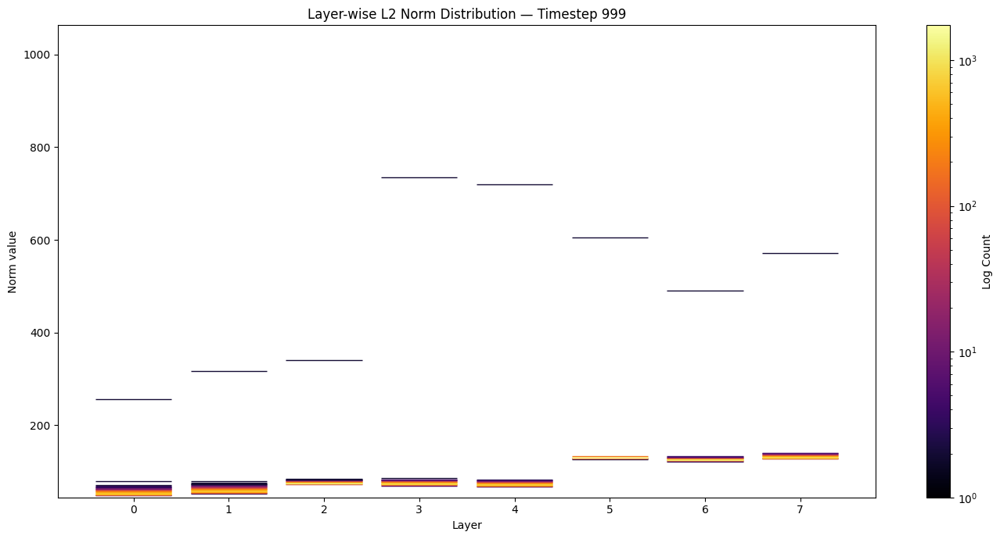

/tmp/ipython-input-1549221053.py:79: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = get_cmap("inferno") # Use 'inferno' as in your example


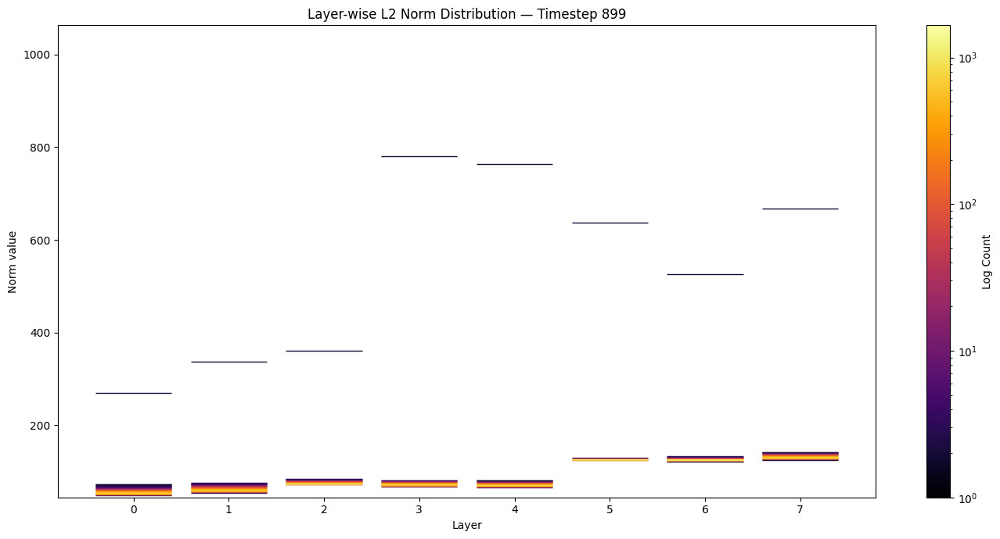

/tmp/ipython-input-1549221053.py:79: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = get_cmap("inferno") # Use 'inferno' as in your example


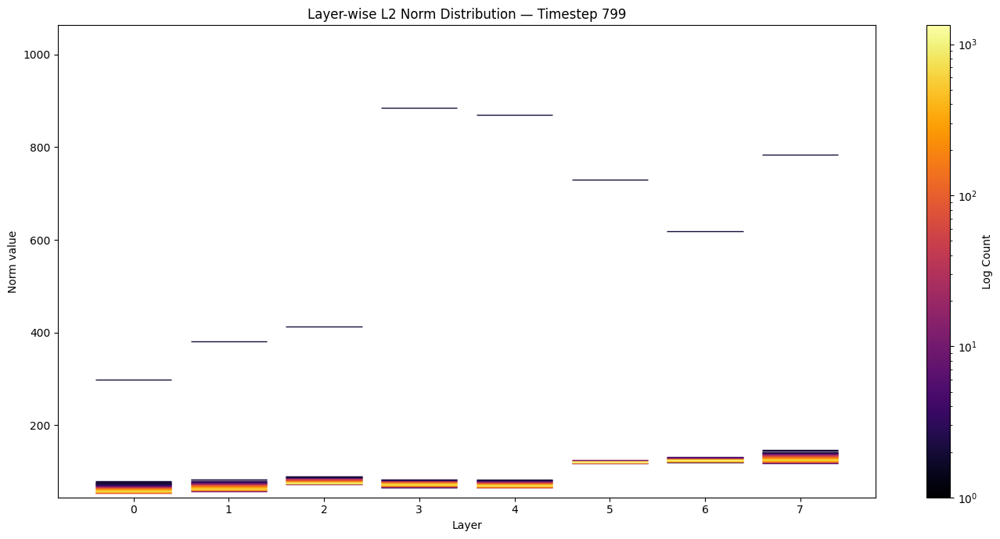

/tmp/ipython-input-1549221053.py:79: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = get_cmap("inferno") # Use 'inferno' as in your example


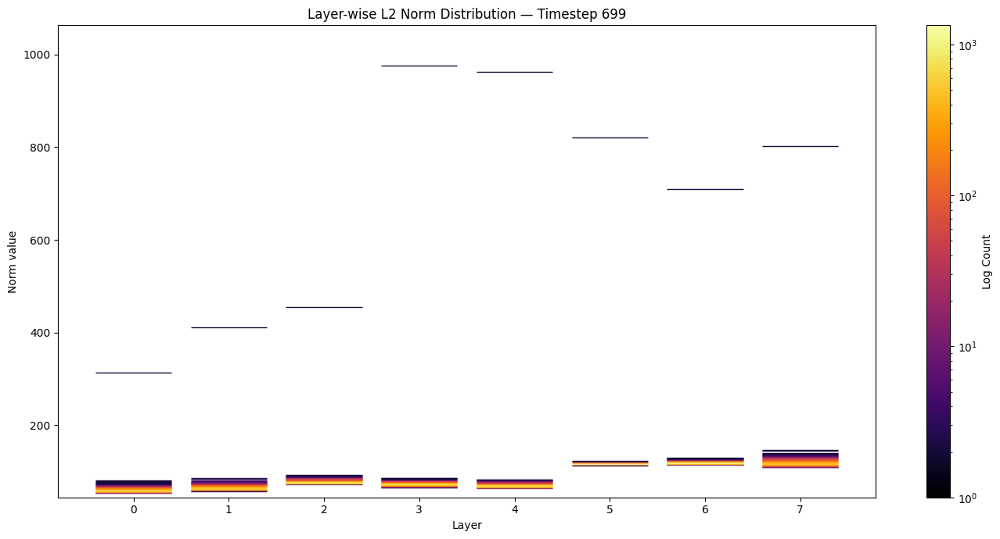

/tmp/ipython-input-1549221053.py:79: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = get_cmap("inferno") # Use 'inferno' as in your example


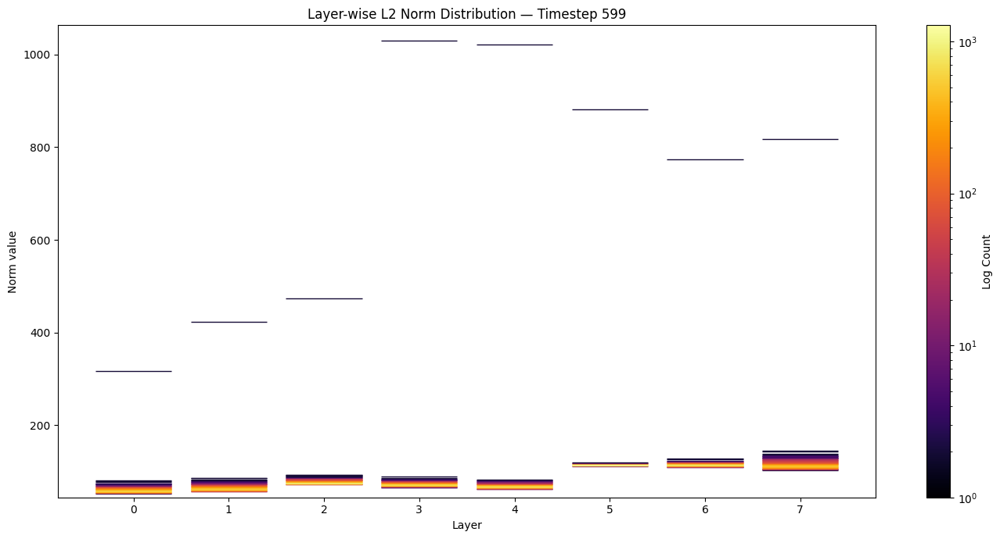

/tmp/ipython-input-1549221053.py:79: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = get_cmap("inferno") # Use 'inferno' as in your example


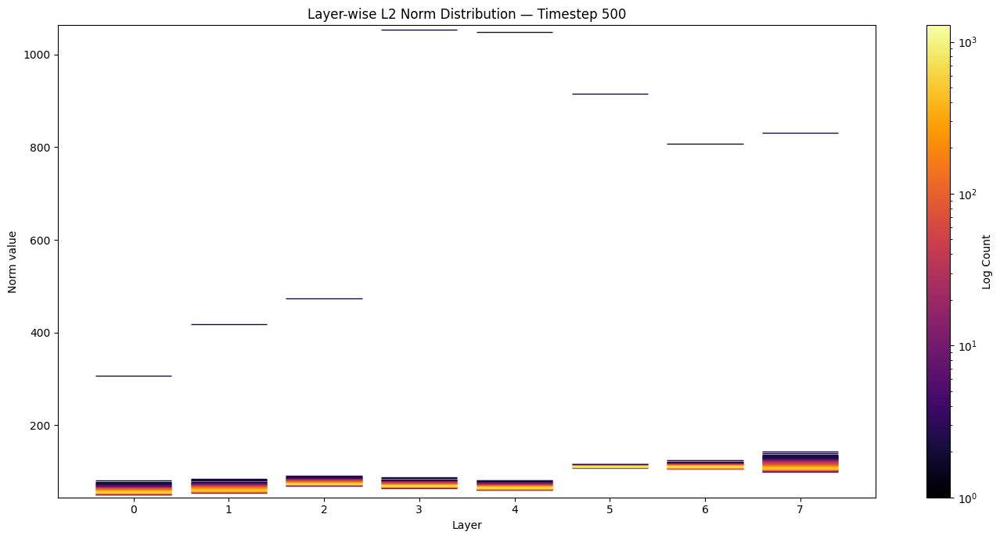

/tmp/ipython-input-1549221053.py:79: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = get_cmap("inferno") # Use 'inferno' as in your example


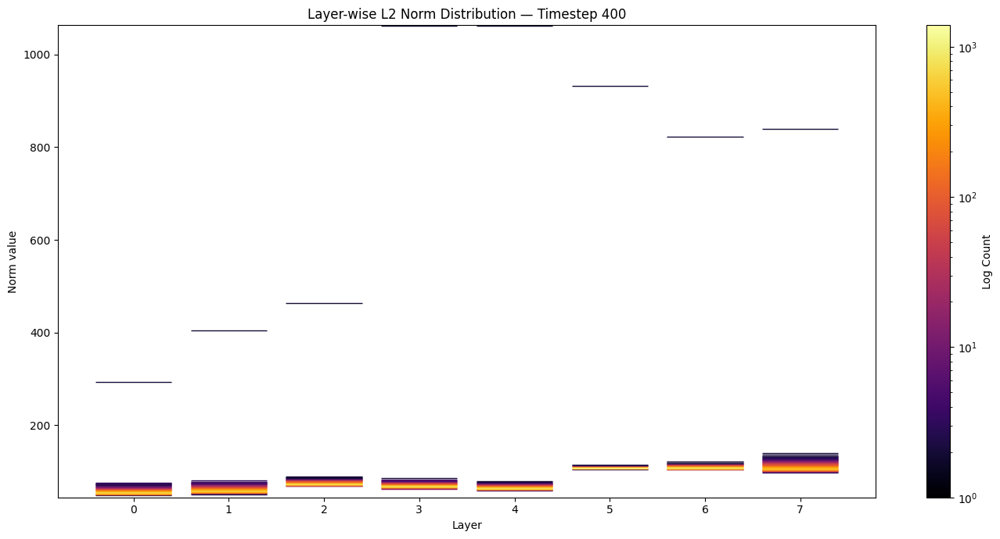

/tmp/ipython-input-1549221053.py:79: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = get_cmap("inferno") # Use 'inferno' as in your example


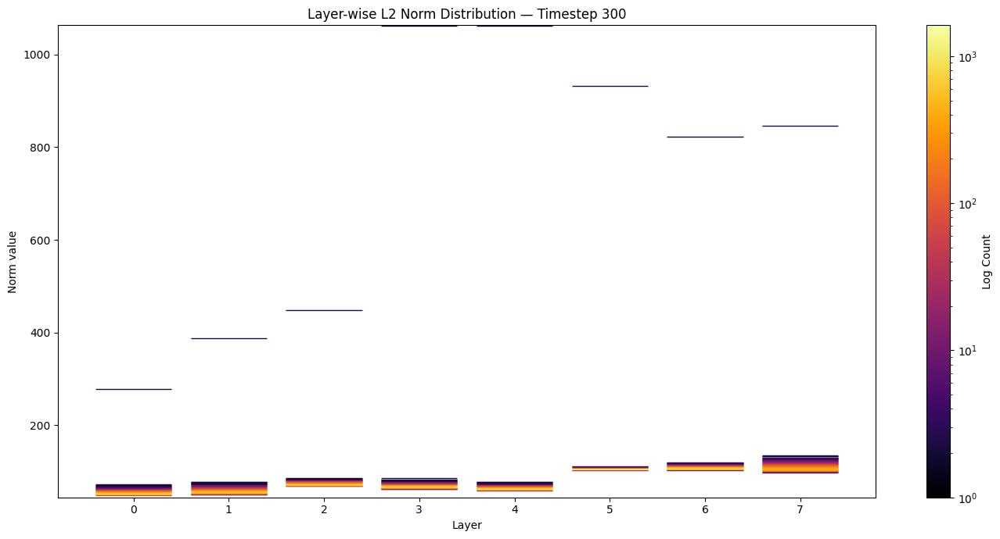

/tmp/ipython-input-1549221053.py:79: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = get_cmap("inferno") # Use 'inferno' as in your example


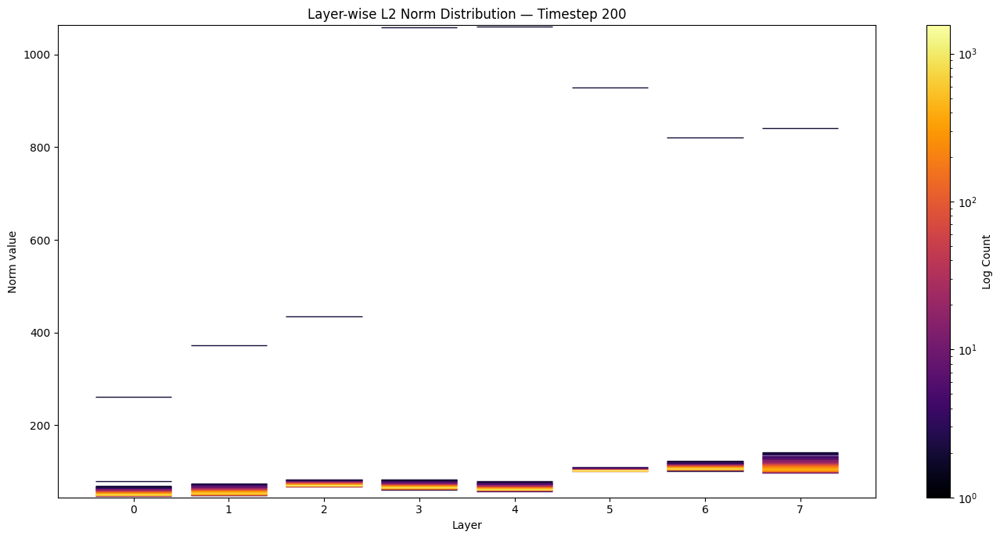

/tmp/ipython-input-1549221053.py:79: MatplotlibDeprecationWarning: The get_cmap function was deprecated in Matplotlib 3.7 and will be removed in 3.11. Use ``matplotlib.colormaps[name]`` or ``matplotlib.colormaps.get_cmap()`` or ``pyplot.get_cmap()`` instead.
  cmap = get_cmap("inferno") # Use 'inferno' as in your example


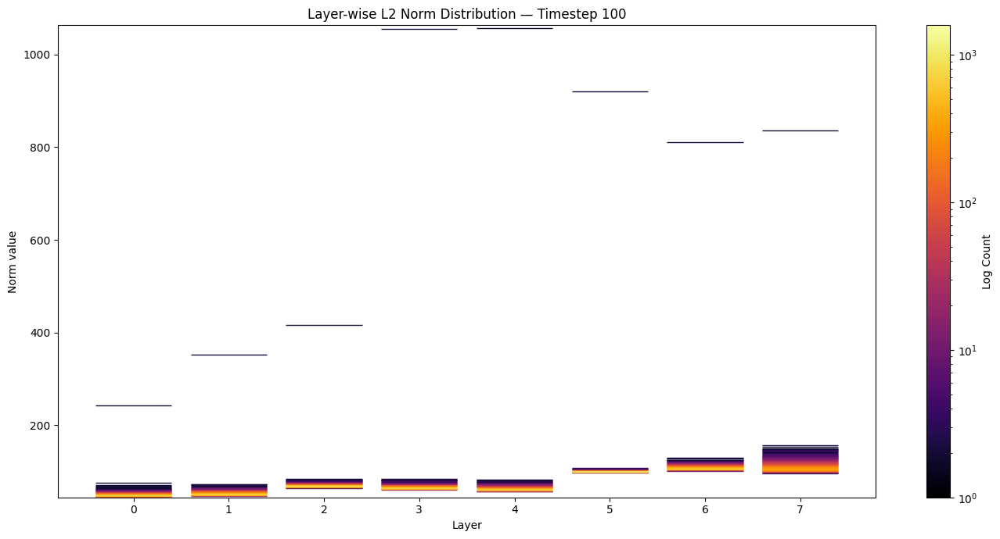

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import LogNorm, Normalize
from matplotlib.cm import get_cmap
import torch

def plot_layerwise_norm_distribution(all_activations: dict, bins: int = 950, title: str = "Layer-wise L2 Norm Distribution"):
    """
    Calculates the L2 norm for each token's activation vector and plots the distribution
    of these norms for each layer in the style of horizontal lines for each timestep.

    Args:
        all_activations (dict): A nested dictionary with the structure {layer_name: {timestep: tensor}}.
                                The tensor shape is (batch, tokens, features).
        bins (int): The number of bins to use for the histogram.
        title (str): The main title for the plots.
    """
    if not all_activations:
        print("The 'all_activations' dictionary is empty. No data to plot.")
        return

    # --- 1. Calculate L2 norms ---
    print("Calculating L2 norms for all activations...")
    layer_norms = {}
    sorted_layer_names = sorted(all_activations.keys(), key=lambda name: int(name.split('.')[-1]))

    for layer_name in sorted_layer_names:
        layer_norms[layer_name] = {}
        for timestep, tensor in all_activations[layer_name].items():
            activations_float32 = tensor.to(torch.float32)
            norms = torch.linalg.norm(activations_float32, ord=2, dim=-1)
            layer_norms[layer_name][timestep] = norms

    # --- 2. Flatten all norms to compute a consistent range for the bins ---
    print("Calculating global norm value range...")
    all_values = []
    for layer_name in sorted_layer_names:
        for timestep in layer_norms[layer_name]:
            all_values.append(layer_norms[layer_name][timestep].numpy().flatten())

    if all_values:
        all_values = np.concatenate(all_values)
    else:
        print("No norm tensors found after calculation.")
        return

    # Determine bin edges and centers
    # Use global min/max for consistent binning across all plots
    min_norm_val = all_values.min()
    max_norm_val = all_values.max()
    bin_edges = np.linspace(min_norm_val, max_norm_val, bins + 1)
    bin_centers = 0.5 * (bin_edges[:-1] + bin_edges[1:])

    print(f"Global norm range: {min_norm_val:.2f} to {max_norm_val:.2f}")

    # --- 3. Create a plot for each timestep ---
    timesteps = sorted(list(next(iter(layer_norms.values())).keys()), reverse=True) # Sort in descending order

    for t in timesteps:
        fig, ax = plt.subplots(figsize=(14, 7))

        # We need a global max count for consistent color mapping across all bins/layers/timesteps
        # Find the maximum count across all histograms for this timestep
        max_log_count_for_timestep = 1 # Initialize to 1 to avoid log(0) issues

        # Collect all histogram counts for this timestep to determine color scaling
        all_counts_for_timestep = []
        for j, layer_name in enumerate(sorted_layer_names):
            if t in layer_norms[layer_name] and layer_norms[layer_name][t].numel() > 0:
                norms_tensor = layer_norms[layer_name][t]
                counts, _ = np.histogram(norms_tensor.numpy(), bins=bin_edges)
                all_counts_for_timestep.append(counts)

        if all_counts_for_timestep:
             # Flatten and get max count for normalization
            max_log_count_for_timestep = np.max(np.log10(np.concatenate(all_counts_for_timestep) + 1)) # +1 to handle 0 counts safely

        # Define the colormap and normalization for the lines
        cmap = get_cmap("inferno") # Use 'inferno' as in your example
        norm = Normalize(vmin=0, vmax=max_log_count_for_timestep) # Normalize based on log counts

        for j, layer_name in enumerate(sorted_layer_names):
            if t in layer_norms[layer_name] and layer_norms[layer_name][t].numel() > 0:
                norms_tensor = layer_norms[layer_name][t]
                counts, _ = np.histogram(norms_tensor.numpy(), bins=bin_edges)

                # Plot each bin as a horizontal line
                for bin_idx, count in enumerate(counts):
                    if count > 0:
                        norm_val = bin_centers[bin_idx]

                        # Calculate log count for color mapping
                        log_count = np.log10(count + 1) # Add 1 to handle zero counts and for smoother log scale

                        # Map log_count to color
                        color = cmap(norm(log_count))

                        # Draw a horizontal line
                        # x-coordinates: [j - 0.4, j + 0.4] to give some width to the 'layer'
                        # y-coordinates: [norm_val, norm_val]
                        ax.hlines(
                            y=norm_val,
                            xmin=j - 0.4,
                            xmax=j + 0.4,
                            color=color,
                            linewidth=1 # You can adjust linewidth for desired 'thickness'
                        )

        # --- 4. Configure plot aesthetics ---
        ax.set_xlabel("Layer")
        ax.set_ylabel("Norm value")
        ax.set_title(f"{title} — Timestep {t}")

        # Set x-axis ticks to represent layer indices (0-7 for 8 layers, or 13-20 if mapped)
        # Assuming you want to display 0-indexed layers as in Image 1
        ax.set_xticks(np.arange(len(sorted_layer_names)))
        # Map original layer indices (12-19) to 0-indexed labels for the plot
        ax.set_xticklabels([str(i) for i in range(len(sorted_layer_names))])

        # Set y-axis limits to match the global norm range
        ax.set_ylim(min_norm_val, max_norm_val)

        # Create a dummy colorbar to represent the log count
        # This is a bit manual since we're not using imshow
        sm = plt.cm.ScalarMappable(cmap=cmap, norm=LogNorm(vmin=1, vmax=np.power(10, max_log_count_for_timestep)-1)) # vmax is max actual count
        sm.set_array([]) # Or any array of values that maps to the norm range
        cbar = fig.colorbar(sm, ax=ax, label="Log Count")

        plt.tight_layout()
        plt.show()


# --- Example of how to use the function with your `all_activations` ---
if __name__ == '__main__':
    plot_layerwise_norm_distribution(all_activations)

In [ ]:
target_layers = [f"transformer_blocks.{i}" for i in range(0, 28)]
prompt = "Airplane docked in hangar during golden hour"
activations_test = run_and_collect(
                pipe,
                prompt=prompt,
                layer_names=target_layers,
                num_inference_steps=10
            )

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Calculating L2 norms for all activations...
Calculating global norm value range...
Global norm range: 27.96 to 1076.64


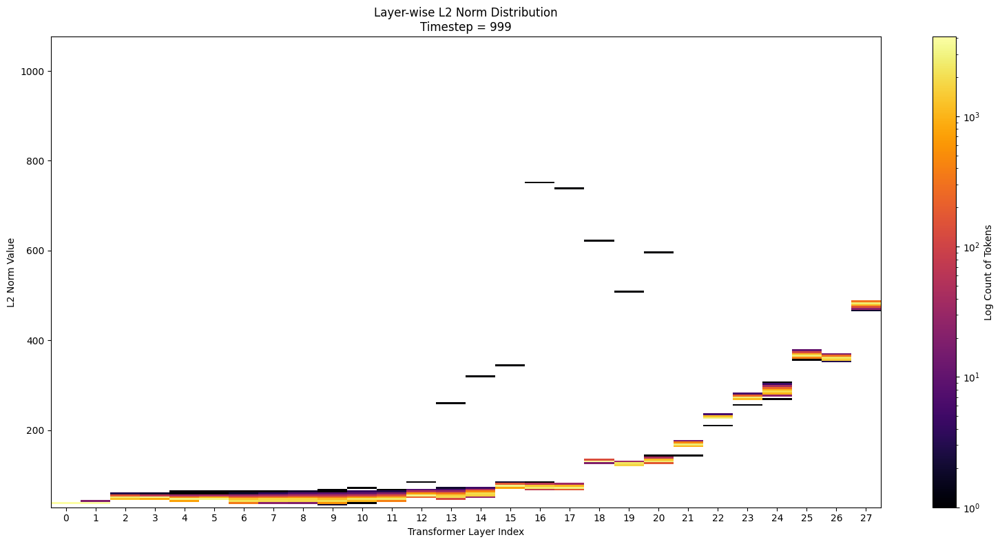

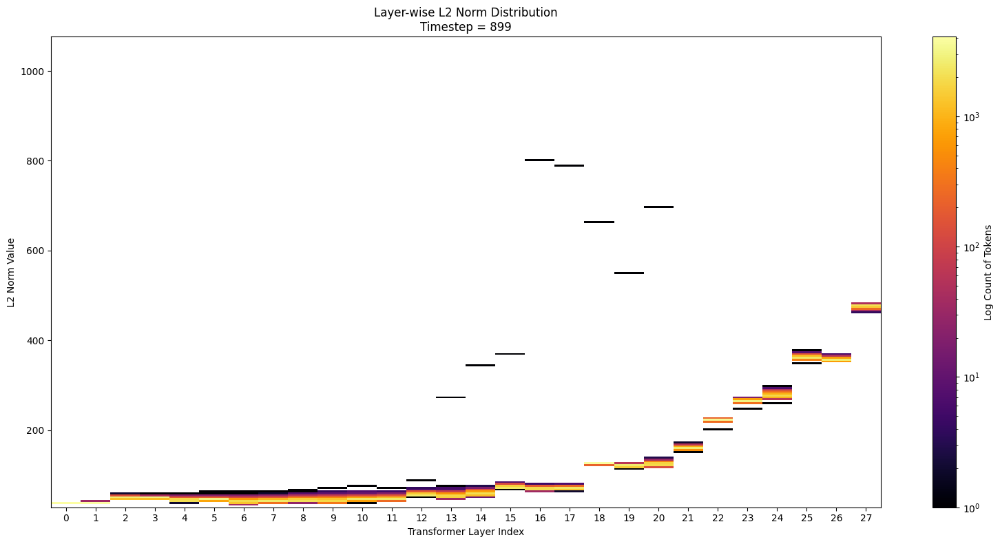

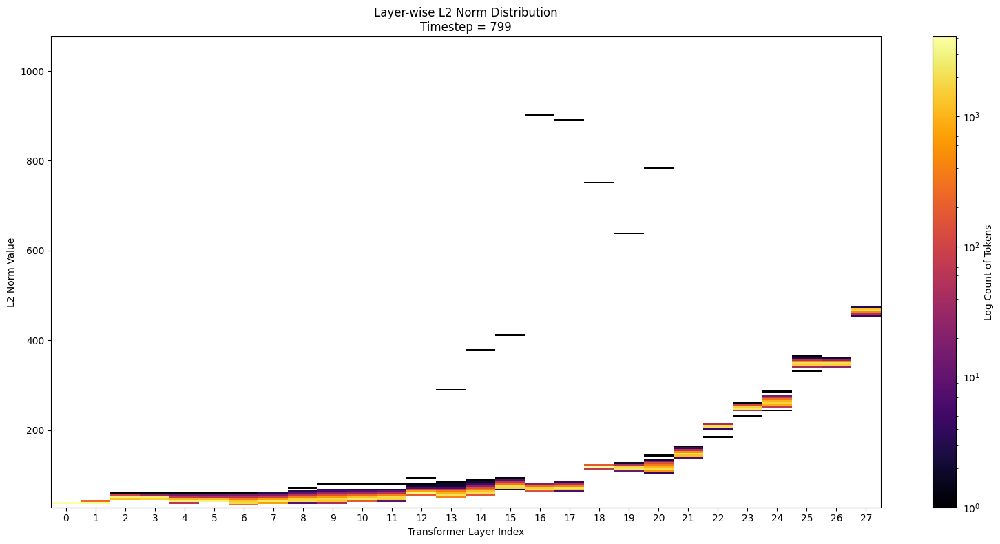

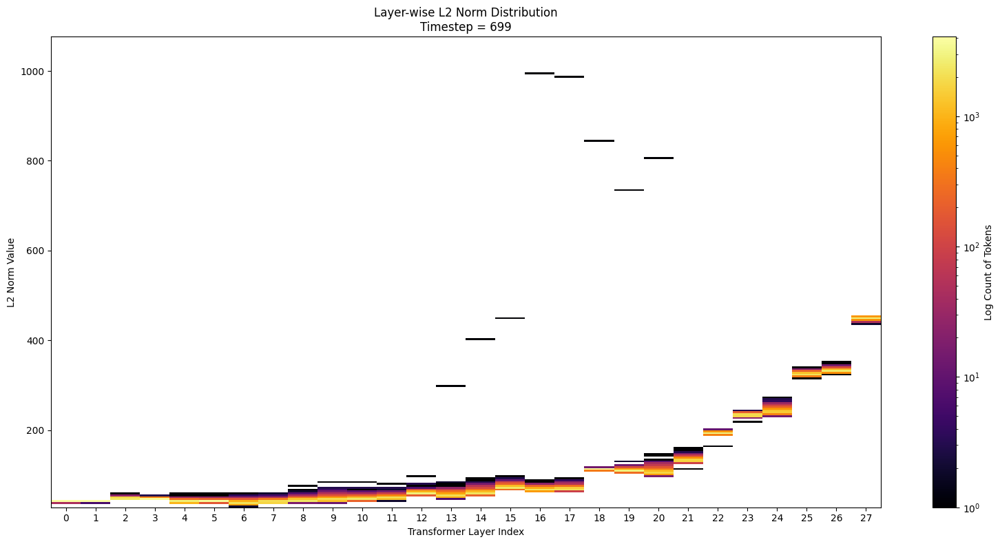

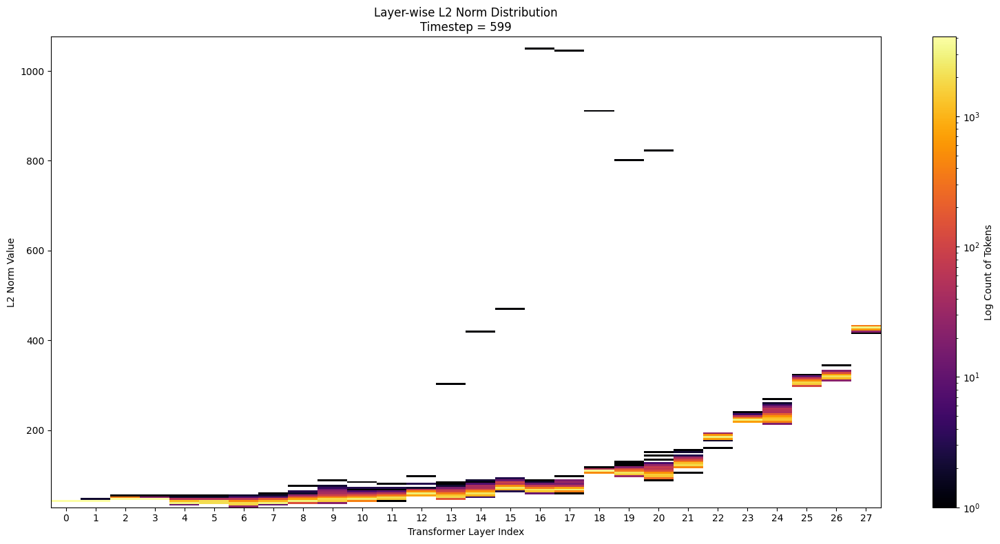

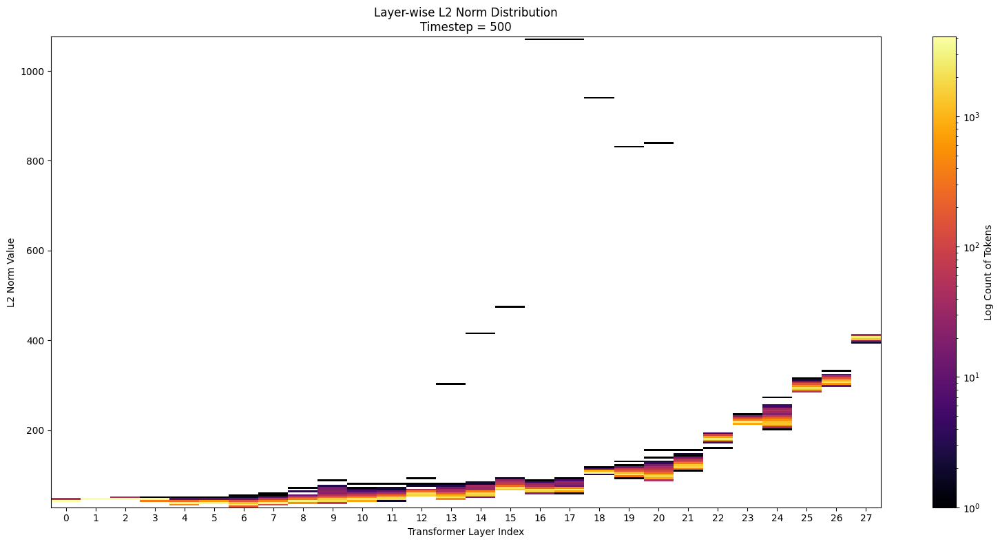

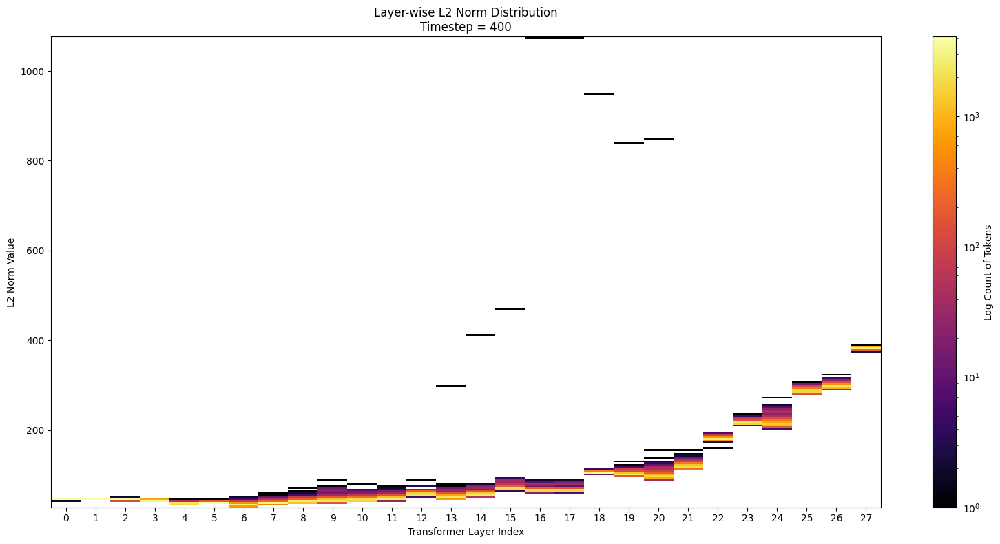

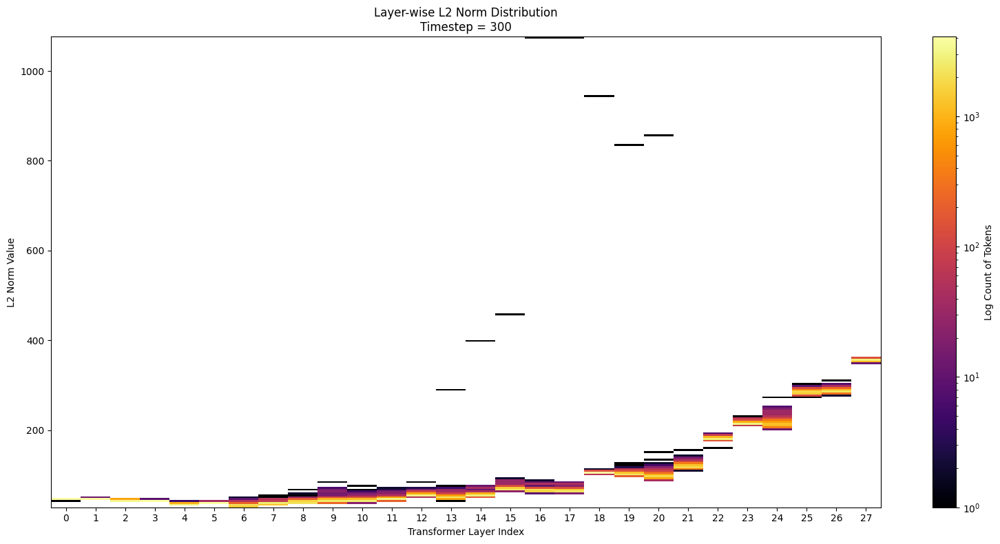

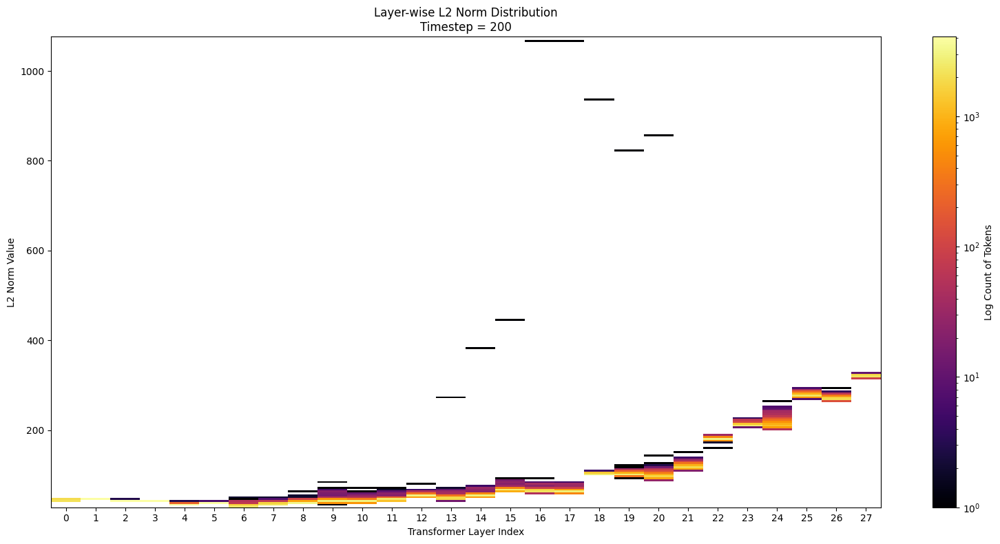

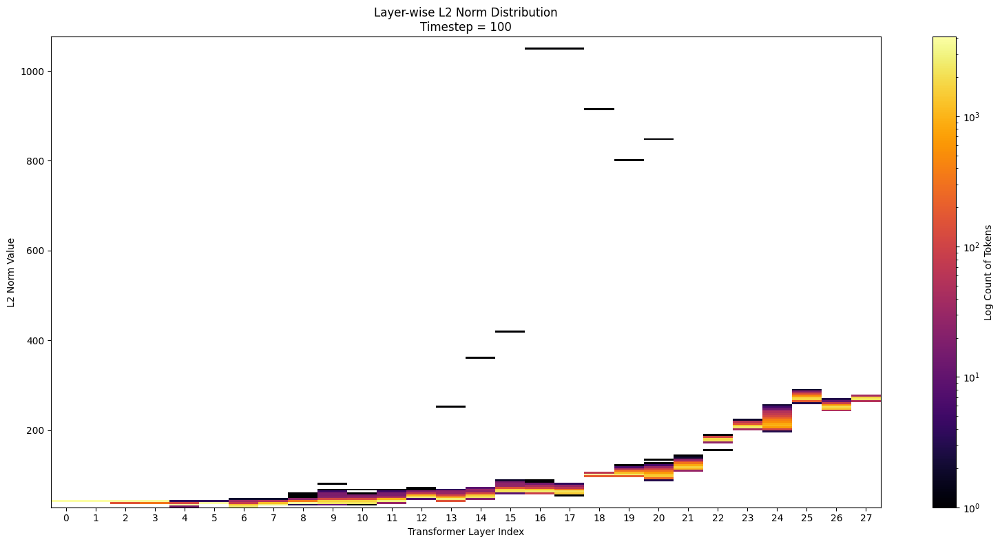

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.colors import LogNorm
import torch

def plot_layerwise_norm_distribution(all_activations: dict, bins: int = 950, title: str = "Layer-wise L2 Norm Distribution"):
    """
    Calculates L2 norms and plots their distribution as a solid, block-style
    heatmap for each timestep, with no gaps between layers.

    Args:
        all_activations (dict): A nested dictionary with the structure {layer_name: {timestep: tensor}}.
        bins (int): The number of bins to use for the histogram.
        title (str): The main title for the plots.
    """
    if not all_activations:
        print("The 'all_activations' dictionary is empty. No data to plot.")
        return

    # --- 1. Calculate L2 norms ---
    print("Calculating L2 norms for all activations...")
    layer_norms = {}
    sorted_layer_names = sorted(all_activations.keys(), key=lambda name: int(name.split('.')[-1]))

    for layer_name in sorted_layer_names:
        layer_norms[layer_name] = {}
        for timestep, tensor in all_activations[layer_name].items():
            activations_float32 = tensor.to(torch.float32)
            norms = torch.linalg.norm(activations_float32, ord=2, dim=-1)
            layer_norms[layer_name][timestep] = norms

    # --- 2. Flatten all norms to compute a consistent range for the bins ---
    print("Calculating global norm value range...")
    all_values = []
    for layer_name in sorted_layer_names:
        for timestep in layer_norms[layer_name]:
            all_values.append(layer_norms[layer_name][timestep].numpy().flatten())

    if all_values:
        all_values = np.concatenate(all_values)
    else:
        print("No norm tensors found after calculation.")
        return

    min_norm_val = all_values.min()
    max_norm_val = all_values.max()
    bin_edges = np.linspace(min_norm_val, max_norm_val, bins + 1)

    print(f"Global norm range: {min_norm_val:.2f} to {max_norm_val:.2f}")

    # --- 3. Create a plot for each timestep ---
    timesteps = sorted(list(next(iter(layer_norms.values())).keys()), reverse=True)

    for t in timesteps:
        # First, build the full matrix of histogram counts for this timestep
        heatmap_matrix = np.zeros((bins, len(sorted_layer_names)))
        max_count = 1.0 # To avoid issues with empty plots

        for j, layer_name in enumerate(sorted_layer_names):
            if t in layer_norms[layer_name] and layer_norms[layer_name][t].numel() > 0:
                norms_tensor = layer_norms[layer_name][t]
                counts, _ = np.histogram(norms_tensor.numpy(), bins=bin_edges)
                heatmap_matrix[:, j] = counts

        max_count = max(heatmap_matrix.max(), 1.0)

        # --- 4. Plot the heatmap using imshow ---
        fig, ax = plt.subplots(figsize=(16, 8))

        im = ax.imshow(
            heatmap_matrix,
            aspect='auto',
            origin='lower',
            cmap='inferno',
            norm=LogNorm(vmin=1, vmax=max_count),
            interpolation='nearest',  # This is the key change for the blocky look
            # Set extent to map matrix cells to axis coordinates
            extent=[-0.5, len(sorted_layer_names) - 0.5, min_norm_val, max_norm_val]
        )

        fig.colorbar(im, ax=ax, label="Log Count of Tokens")

        # Configure ticks to show the actual layer index
        tick_indices = np.arange(len(sorted_layer_names))
        tick_labels = [name.split('.')[-1] for name in sorted_layer_names]
        ax.set_xticks(ticks=tick_indices)
        ax.set_xticklabels(tick_labels)

        ax.set_xlabel("Transformer Layer Index")
        ax.set_ylabel("L2 Norm Value")
        ax.set_title(f"{title}\nTimestep = {t}")
        plt.tight_layout()
        plt.show()

if __name__ == '__main__':
    plot_layerwise_norm_distribution(activations_test, bins=250)

### Collecting ALL Activations

#### Save locally then save to Drive

In [ ]:
import os
import shutil
from tqdm.auto import tqdm
import time
import torch

# Define the final storage path in your Google Drive
gdrive_base_dir = "/content/drive/MyDrive/Algoverse/Linear_Probe_Data/activations"
os.makedirs(gdrive_base_dir, exist_ok=True)

# Define the layers you want to probe
target_layers = [f"transformer_blocks.{i}" for i in range(13, 21)]
class_names = prompts_df.columns

print(f"Starting activation collection for {len(class_names)} classes.")
print(f"Activations will be saved in: {gdrive_base_dir}")

# --- Loop through each class and prompt ---
for class_name in class_names:
    print(f"\n--- Processing Class: {class_name} ---")

    # Create the final destination subdirectory for the class
    class_dir_gdrive = os.path.join(gdrive_base_dir, class_name)
    os.makedirs(class_dir_gdrive, exist_ok=True)

    prompts_for_class = prompts_df[class_name].dropna().tolist()

    for i, prompt in enumerate(tqdm(prompts_for_class, desc=f"Prompts for {class_name}")):
        try:
            # 1. Generate the activations for the prompt
            activations = run_and_collect(
                pipe,
                prompt=prompt,
                layer_names=target_layers,
                num_inference_steps=10
            )

            # 2. Define a temporary local path and the final destination path
            file_name = f"prompt_{i:03d}.pt"
            temp_local_path = f"/content/{file_name}" # Save to root of local storage
            final_gdrive_path = os.path.join(class_dir_gdrive, file_name)

            # 3. Save to the fast local disk first
            torch.save(activations, temp_local_path)

            # 4. Move the completed file to Google Drive
            shutil.move(temp_local_path, final_gdrive_path)

        except Exception as e:
            print(f"  ERROR: Failed to process prompt {i+1} for class '{class_name}'. Skipping.")
            print(f"  Error details: {e}")
            # Ensure the temporary file is cleaned up if it exists
            if os.path.exists(temp_local_path):
                os.remove(temp_local_path)
            continue

print("\n\n All classes have been processed and saved to Google Drive.")

Starting activation collection for 10 classes.
Activations will be saved in: /content/drive/MyDrive/Algoverse/Linear_Probe_Data/activations

--- Processing Class: airplane ---


Prompts for airplane:   0%|          | 0/50 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]


--- Processing Class: automobile ---


Prompts for automobile:   0%|          | 0/50 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]


--- Processing Class: bird ---


Prompts for bird:   0%|          | 0/50 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]


--- Processing Class: cat ---


Prompts for cat:   0%|          | 0/50 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]


--- Processing Class: deer ---


Prompts for deer:   0%|          | 0/50 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]


--- Processing Class: dog ---


Prompts for dog:   0%|          | 0/50 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]


--- Processing Class: frog ---


Prompts for frog:   0%|          | 0/50 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]


--- Processing Class: horse ---


Prompts for horse:   0%|          | 0/50 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]


--- Processing Class: ship ---


Prompts for ship:   0%|          | 0/50 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]


--- Processing Class: truck ---


Prompts for truck:   0%|          | 0/50 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]

Running custom diffusion loop with hooks...


  0%|          | 0/10 [00:00<?, ?it/s]



🎉 All classes have been processed and saved to Google Drive.


## Separating Norms

### Calculating Global Threshold (Sampling)

In [ ]:
import os
import glob
import torch
from tqdm.auto import tqdm

def calculate_global_norm_threshold(base_dir: str, percentile: float = 0.9, sample_fraction: float = 0.1) -> float:
    """
    Iterates through all saved activation files, calculates L2 norms, and determines a
    global norm threshold by sub-sampling for memory efficiency.

    Args:
        base_dir (str): The root directory where the class folders of activations are saved.
        percentile (float): The percentile to use for the threshold (e.g., 0.9 for 90th).
        sample_fraction (float): The fraction of total norms to sample (e.g., 0.1 for 10%).

    Returns:
        float: The calculated global norm threshold.
    """
    print(f"Scanning for all '.pt' files in '{base_dir}'...")
    all_files = glob.glob(os.path.join(base_dir, '**', '*.pt'), recursive=True)

    if not all_files:
        print("Error: No '.pt' files found. Please check the base_dir path.")
        return 0.0

    print(f"Found {len(all_files)} files. Calculating all norms...")

    all_norms_list = []
    for file_path in tqdm(all_files, desc="Processing files"):
        try:
            activations_dict = torch.load(file_path, weights_only=False)
            for layer_name in activations_dict:
                for timestep in activations_dict[layer_name]:
                    tensor = activations_dict[layer_name][timestep]
                    norms = torch.linalg.norm(tensor.to(torch.float32), ord=2, dim=-1).flatten()
                    all_norms_list.append(norms)
        except Exception as e:
            print(f"Warning: Could not process file {file_path}. Error: {e}")
            continue

    if not all_norms_list:
        print("Error: Could not extract any norms from the files.")
        return 0.0

    # --- FIX: Sub-sample from the list of tensors before concatenating ---
    print(f"Sub-sampling {sample_fraction*100:.0f}% of norms for memory-efficient calculation...")
    sampled_norms_list = []
    for norms_tensor in tqdm(all_norms_list, desc="Sampling norms"):
        # Calculate how many samples to take from this chunk
        num_elements = norms_tensor.numel()
        num_samples = int(num_elements * sample_fraction)

        # Get random indices and take a sample
        indices = torch.randperm(num_elements)[:num_samples]
        sampled_norms_list.append(norms_tensor[indices])

    print("Concatenating sampled norms into a single tensor...")
    # This final tensor is now much smaller and manageable
    final_sampled_tensor = torch.cat(sampled_norms_list)

    print(f"Calculating the {percentile*100:.0f}th percentile threshold on the sample...")
    threshold = torch.quantile(final_sampled_tensor, percentile)

    return threshold.item()

# --- Run the function again ---
if __name__ == '__main__':
    gdrive_activations_dir = "/content/drive/MyDrive/Algoverse/Linear_Probe_Data/activations"

    # Calculate the 90th percentile threshold using a 10% sample of the data
    global_threshold = calculate_global_norm_threshold(
        gdrive_activations_dir,
        percentile=0.9,
        sample_fraction=0.1
    )

    print("\n" + "="*50)
    print(f"✅ The global 90th percentile norm threshold is: {global_threshold:.4f}")
    print("="*50)

Scanning for all '.pt' files in '/content/drive/MyDrive/Algoverse/Linear_Probe_Data/activations'...
Found 500 files. Calculating all norms...


Processing files:   0%|          | 0/500 [00:00<?, ?it/s]

Sub-sampling 10% of norms for memory-efficient calculation...


Sampling norms:   0%|          | 0/40000 [00:00<?, ?it/s]

Concatenating sampled norms into a single tensor...
Calculating the 90th percentile threshold on the sample...

✅ The global 90th percentile norm threshold is: 120.6536


#### Splitting up Norms

In [ ]:
import os
import glob
import torch
import numpy as np
import h5py
from tqdm.auto import tqdm

def create_probing_datasets_h5(base_dir: str, output_h5_path: str, global_threshold: float, class_names: list, layers: list, timesteps: list):
    """
    Processes activation files and saves the resulting (X, y) datasets directly
    to a single HDF5 file to avoid overflowing system RAM.
    """
    class_to_label = {name: i for i, name in enumerate(class_names)}

    print(f"Creating HDF5 file at: {output_h5_path}")
    with h5py.File(output_h5_path, 'w') as hf:
        # Pre-create the group structure inside the HDF5 file
        for layer_name in layers:
            layer_group = hf.create_group(layer_name)
            for ts in timesteps:
                ts_group = layer_group.create_group(str(ts))
                for norm_type in ['high_norm', 'low_norm']:
                    norm_group = ts_group.create_group(norm_type)
                    # Create resizable datasets. We know the feature dimension (1152).
                    norm_group.create_dataset('X', shape=(0, 1152), maxshape=(None, 1152), dtype='f4')
                    norm_group.create_dataset('y', shape=(0,), maxshape=(None,), dtype='i4')

    # Now, process the files and append to the HDF5 datasets
    all_files = glob.glob(os.path.join(base_dir, '**', '*.pt'), recursive=True)
    print(f"Found {len(all_files)} files. Appending data to HDF5 file...")

    for file_path in tqdm(all_files, desc="Processing files"):
        try:
            class_name = os.path.basename(os.path.dirname(file_path))
            label = class_to_label[class_name]
            activations_dict = torch.load(file_path, weights_only=False)

            with h5py.File(output_h5_path, 'a') as hf: # Open in append mode
                for layer_name, timesteps_dict in activations_dict.items():
                    for timestep, tensor in timesteps_dict.items():
                        tensor_unbatched = tensor.to(torch.float32).cpu().squeeze(0)
                        norms = torch.linalg.norm(tensor_unbatched, ord=2, dim=-1)

                        masks = {
                            'high_norm': norms > global_threshold,
                            'low_norm': norms <= global_threshold
                        }

                        for norm_type, mask in masks.items():
                            if mask.any():
                                vectors = tensor_unbatched[mask]
                                mean_vector = vectors.mean(dim=0).numpy()

                                # Get the correct dataset from the HDF5 file
                                ds_X = hf[layer_name][str(timestep)][norm_type]['X']
                                ds_y = hf[layer_name][str(timestep)][norm_type]['y']

                                # Resize the datasets to append one new row
                                ds_X.resize((ds_X.shape[0] + 1, ds_X.shape[1]))
                                ds_y.resize((ds_y.shape[0] + 1,))

                                # Append the new data
                                ds_X[-1, :] = mean_vector
                                ds_y[-1] = label
        except Exception as e:
            print(f"Warning: Could not process file {file_path}. Error: {e}")
            continue

    print("✅ HDF5 dataset creation complete!")

# --- How to Run ---
if __name__ == '__main__':
    global_threshold = 120.6536
    gdrive_activations_dir = "/content/drive/MyDrive/Algoverse/Linear_Probe_Data/activations"
    output_h5_file = "/content/drive/MyDrive/Algoverse/Linear_Probe_Data/probing_datasets.h5"
    cifar10_classes = sorted(['airplane', 'automobile', 'bird', 'cat', 'deer', 'dog', 'frog', 'horse', 'ship', 'truck'])

    # We need to know the layers and timesteps to pre-create the HDF5 structure
    # You can get this from one of your files or define them manually
    layer_names = [f'transformer_blocks.{i}' for i in range(13, 21)]
    # You can get the timesteps from the pipe scheduler you used

    # --- Faster way to get timesteps ---
    from diffusers.schedulers import DPMSolverMultistepScheduler

    # Load only the scheduler's configuration from the Hub
    scheduler_config = DPMSolverMultistepScheduler.load_config(
        "PixArt-alpha/PixArt-Sigma-XL-2-1024-MS",
        subfolder="scheduler"
    )

    # Create a scheduler instance from that config
    scheduler = DPMSolverMultistepScheduler.from_config(scheduler_config)

    # Get the timesteps
    scheduler.set_timesteps(10)
    timesteps = scheduler.timesteps.numpy().tolist()

    print("Timesteps loaded successfully without downloading the full model.")
    print(timesteps)

    create_probing_datasets_h5(
        gdrive_activations_dir,
        output_h5_file,
        global_threshold,
        cifar10_classes,
        layer_names,
        timesteps
    )

/usr/local/lib/python3.12/dist-packages/huggingface_hub/utils/_auth.py:94: UserWarning: 
The secret `HF_TOKEN` does not exist in your Colab secrets.
To authenticate with the Hugging Face Hub, create a token in your settings tab (https://huggingface.co/settings/tokens), set it as secret in your Google Colab and restart your session.
You will be able to reuse this secret in all of your notebooks.
Please note that authentication is recommended but still optional to access public models or datasets.
  warnings.warn(


scheduler_config.json:   0%|          | 0.00/655 [00:00<?, ?B/s]

Timesteps loaded successfully without downloading the full model.
[999, 899, 799, 699, 599, 500, 400, 300, 200, 100]
Creating HDF5 file at: /content/drive/MyDrive/Algoverse/Linear_Probe_Data/probing_datasets.h5
Found 500 files. Appending data to HDF5 file...


Processing files:   0%|          | 0/500 [00:00<?, ?it/s]

✅ HDF5 dataset creation complete!


## Training Linear Probe

In [ ]:
import h5py
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
from sklearn.linear_model import LogisticRegression
from tqdm.auto import tqdm
import warnings

# Suppress convergence warnings from scikit-learn for cleaner output
from sklearn.exceptions import ConvergenceWarning
warnings.filterwarnings("ignore", category=ConvergenceWarning)

def run_linear_probe_experiment(h5_path: str):
    """
    Loads data from the HDF5 file, trains a linear probe for each condition,
    and returns a dictionary of the accuracy results.
    """
    results = {}

    print(f"Loading data from {h5_path}...")
    with h5py.File(h5_path, 'r') as hf:
        # Get the structure of the experiment from the HDF5 file keys
        layers = sorted(hf.keys(), key=lambda name: int(name.split('.')[-1]))
        timesteps = sorted(hf[layers[0]].keys(), key=int)
        norm_types = ['high_norm', 'low_norm']

        # Use tqdm for a nested progress bar
        for layer_name in tqdm(layers, desc="Layers"):
            results[layer_name] = {}
            for timestep_str in tqdm(timesteps, desc=f"Timesteps for {layer_name}", leave=False):
                results[layer_name][int(timestep_str)] = {}

                for norm_type in norm_types:
                    try:
                        # Load the X and y data for this specific condition
                        X = hf[layer_name][timestep_str][norm_type]['X'][:]
                        y = hf[layer_name][timestep_str][norm_type]['y'][:]

                        # Skip if there's not enough data to train a meaningful model
                        if len(y) < 50: # At least 50 samples
                            results[layer_name][int(timestep_str)][norm_type] = np.nan
                            continue

                        # 1. Split data into training and testing sets
                        X_train, X_test, y_train, y_test = train_test_split(
                            X, y, test_size=0.2, random_state=42, stratify=y
                        )

                        # 2. Scale features (fit ONLY on training data)
                        scaler = StandardScaler()
                        X_train_scaled = scaler.fit_transform(X_train)
                        X_test_scaled = scaler.transform(X_test)

                        # 3. Train the logistic regression model
                        probe = LogisticRegression(max_iter=1000, random_state=42, C=0.01)
                        probe.fit(X_train_scaled, y_train)

                        # 4. Evaluate and store the accuracy
                        accuracy = probe.score(X_test_scaled, y_test)
                        results[layer_name][int(timestep_str)][norm_type] = accuracy

                    except KeyError:
                        # Handle cases where a specific dataset might not exist in the HDF5
                        results[layer_name][int(timestep_str)][norm_type] = np.nan
                        continue

    return results

# --- How to Run ---
if __name__ == '__main__':
    h5_file_path = "/content/drive/MyDrive/Algoverse/Linear_Probe_Data/probing_datasets.h5"

    # This will take some time to run as it trains hundreds of models
    experiment_results = run_linear_probe_experiment(h5_file_path)

    print("\n✅ Experiment complete!")

    # Save the results dictionary so you don't have to run it again
    import pickle
    results_path = "/content/drive/MyDrive/Algoverse/Linear_Probe_Data/probe_results.pkl"
    with open(results_path, 'wb') as f:
        pickle.dump(experiment_results, f)
    print(f"Results saved to {results_path}")

Loading data from /content/drive/MyDrive/Algoverse/Linear_Probe_Data/probing_datasets.h5...


Layers:   0%|          | 0/8 [00:00<?, ?it/s]

Timesteps for transformer_blocks.13:   0%|          | 0/10 [00:00<?, ?it/s]

Timesteps for transformer_blocks.14:   0%|          | 0/10 [00:00<?, ?it/s]

Timesteps for transformer_blocks.15:   0%|          | 0/10 [00:00<?, ?it/s]

Timesteps for transformer_blocks.16:   0%|          | 0/10 [00:00<?, ?it/s]

Timesteps for transformer_blocks.17:   0%|          | 0/10 [00:00<?, ?it/s]

Timesteps for transformer_blocks.18:   0%|          | 0/10 [00:00<?, ?it/s]

Timesteps for transformer_blocks.19:   0%|          | 0/10 [00:00<?, ?it/s]

Timesteps for transformer_blocks.20:   0%|          | 0/10 [00:00<?, ?it/s]


✅ Experiment complete!
Results saved to /content/drive/MyDrive/Algoverse/Linear_Probe_Data/probe_results.pkl


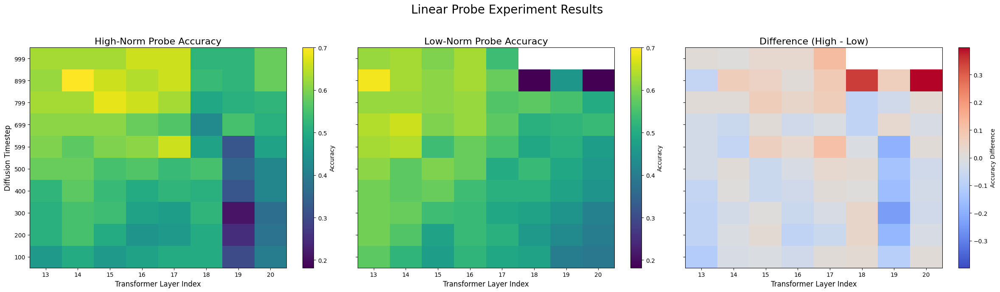

In [ ]:
import pickle
import numpy as np
import matplotlib.pyplot as plt

def plot_probe_results(results: dict):
    """
    Generates three heatmaps to visualize the linear probe accuracy results:
    1. Accuracy of the High-Norm probe.
    2. Accuracy of the Low-Norm probe.
    3. The difference in accuracy between them.
    """
    if not results:
        print("Results dictionary is empty. Nothing to plot.")
        return

    # Extract axes and data from the results dictionary
    # Sort layers and timesteps for correct axis ordering
    layer_names = sorted(results.keys(), key=lambda name: int(name.split('.')[-1]))
    layer_indices_str = [name.split('.')[-1] for name in layer_names]

    timesteps = sorted(results[layer_names[0]].keys())

    # Prepare matrices to hold the heatmap data
    high_norm_matrix = np.zeros((len(timesteps), len(layer_names)))
    low_norm_matrix = np.zeros((len(timesteps), len(layer_names)))

    for i, layer in enumerate(layer_names):
        for j, ts in enumerate(timesteps):
            high_norm_matrix[j, i] = results[layer][ts].get('high_norm', np.nan)
            low_norm_matrix[j, i] = results[layer][ts].get('low_norm', np.nan)

    difference_matrix = high_norm_matrix - low_norm_matrix

    # --- Plotting ---
    fig, axes = plt.subplots(1, 3, figsize=(24, 7), sharey=True)

    # Find global min/max for a consistent accuracy color scale (ignoring NaNs)
    # Defaulting to 0.1 (random chance for 10 classes) if all are NaN
    vmin = np.nanmin([high_norm_matrix, low_norm_matrix]) if not np.all(np.isnan([high_norm_matrix, low_norm_matrix])) else 0.1
    vmax = np.nanmax([high_norm_matrix, low_norm_matrix]) if not np.all(np.isnan([high_norm_matrix, low_norm_matrix])) else 1.0

    # Plot 1: High-Norm Accuracy
    im1 = axes[0].imshow(high_norm_matrix, origin='lower', cmap='viridis', aspect='auto', vmin=vmin, vmax=vmax)
    axes[0].set_title('High-Norm Probe Accuracy', fontsize=16)
    fig.colorbar(im1, ax=axes[0], label='Accuracy')

    # Plot 2: Low-Norm Accuracy
    im2 = axes[1].imshow(low_norm_matrix, origin='lower', cmap='viridis', aspect='auto', vmin=vmin, vmax=vmax)
    axes[1].set_title('Low-Norm Probe Accuracy', fontsize=16)
    fig.colorbar(im2, ax=axes[1], label='Accuracy')

    # Plot 3: Difference
    max_abs_diff = np.nanmax(np.abs(difference_matrix)) if not np.all(np.isnan(difference_matrix)) else 0.1
    im3 = axes[2].imshow(difference_matrix, origin='lower', cmap='coolwarm', aspect='auto', vmin=-max_abs_diff, vmax=max_abs_diff)
    axes[2].set_title('Difference (High - Low)', fontsize=16)
    fig.colorbar(im3, ax=axes[2], label='Accuracy Difference')

    for ax in axes:
        ax.set_xlabel('Transformer Layer Index', fontsize=12)
        ax.set_xticks(np.arange(len(layer_indices_str)))
        ax.set_xticklabels(layer_indices_str)

    axes[0].set_ylabel('Diffusion Timestep', fontsize=12)
    # Use fewer ticks for readability if there are many timesteps
    tick_indices = np.linspace(0, len(timesteps) - 1, num=min(10, len(timesteps)), dtype=int)
    ax.set_yticks(tick_indices)
    ax.set_yticklabels([timesteps[i] for i in tick_indices])

    fig.suptitle('Linear Probe Experiment Results', fontsize=20)
    plt.tight_layout(rect=[0, 0, 1, 0.95])
    plt.show()

# --- How to Run ---
if __name__ == '__main__':
    # Load the results you saved from the experiment
    results_path = "/content/drive/MyDrive/Algoverse/Linear_Probe_Data/probe_results.pkl"
    try:
        with open(results_path, 'rb') as f:
            experiment_results = pickle.load(f)

        plot_probe_results(experiment_results)
    except FileNotFoundError:
        print(f"Error: Results file not found at '{results_path}'. Please check the path.")

#### Histograms

#### Go through each .pt file and aggregate 80 times

Found 500 files. Starting to generate 80 histograms...

Aggregating data for: Layer '13' at Timestep 999


L13 T999:   0%|          | 0/500 [00:00<?, ?it/s]

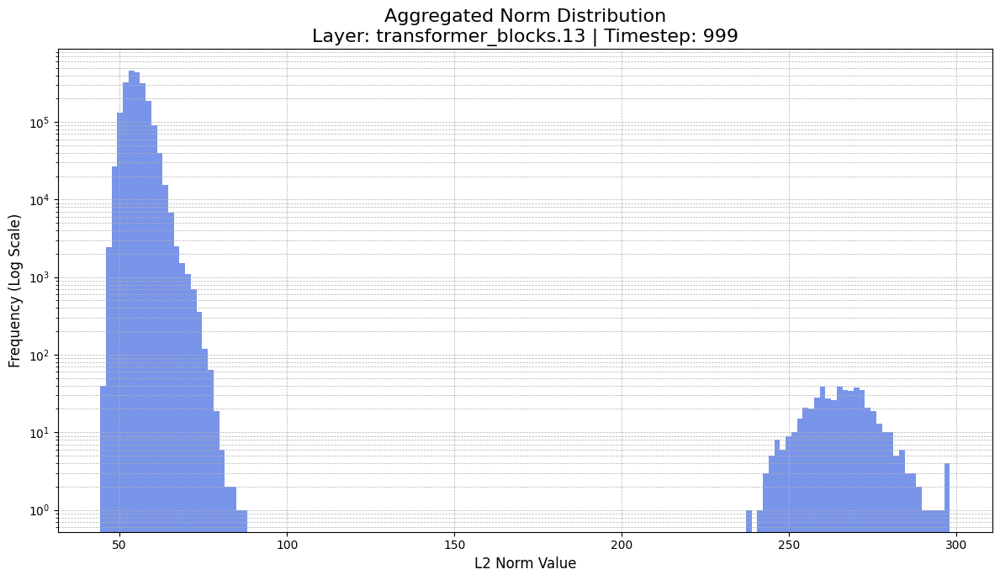


Aggregating data for: Layer '13' at Timestep 899


L13 T899:   0%|          | 0/500 [00:00<?, ?it/s]

KeyboardInterrupt: 

In [ ]:
import os
import glob
import torch
import numpy as np
import matplotlib.pyplot as plt
from tqdm.auto import tqdm
from diffusers.schedulers import DPMSolverMultistepScheduler

def plot_aggregated_norm_histograms(base_dir: str, layers_to_plot: list, timesteps_to_plot: list):
    """
    Generates a histogram of L2 norms for each (layer, timestep) combination,
    aggregated across all saved prompt files.

    Args:
        base_dir (str): The root directory where activation files are saved.
        layers_to_plot (list): A list of layer names to generate plots for.
        timesteps_to_plot (list): A list of integer timesteps to generate plots for.
    """
    all_files = glob.glob(os.path.join(base_dir, '**', '*.pt'), recursive=True)
    if not all_files:
        print(f"Error: No '.pt' files found in '{base_dir}'. Please check the path.")
        return

    print(f"Found {len(all_files)} files. Starting to generate {len(layers_to_plot) * len(timesteps_to_plot)} histograms...")

    # --- Outer loops: Iterate over each experimental condition ---
    for layer_name in layers_to_plot:
        for timestep in timesteps_to_plot:

            print("\n" + "="*60)
            print(f"Aggregating data for: Layer '{layer_name.split('.')[-1]}' at Timestep {timestep}")
            print("="*60)

            aggregated_norms = []

            # --- Inner loop: Iterate through all 500 files for this one condition ---
            for file_path in tqdm(all_files, desc=f"L{layer_name.split('.')[-1]} T{timestep}"):
                try:
                    activations_dict = torch.load(file_path, weights_only=False)

                    # Check if this specific layer and timestep exists in the file
                    if layer_name in activations_dict and timestep in activations_dict[layer_name]:
                        tensor = activations_dict[layer_name][timestep]
                        norms = torch.linalg.norm(tensor.to(torch.float32), ord=2, dim=-1).flatten()
                        aggregated_norms.append(norms)
                except Exception as e:
                    print(f"Warning: Could not process file {file_path}. Error: {e}")
                    continue

            if not aggregated_norms:
                print(f"--> No data found for this combination. Skipping plot.")
                continue

            # --- Data Aggregation and Plotting ---
            # Concatenate all norms from the 500 files into one giant tensor
            final_norms_tensor = torch.cat(aggregated_norms)
            final_norms_np = final_norms_tensor.numpy()

            # Create the plot
            plt.figure(figsize=(12, 7))
            plt.hist(final_norms_np, bins=150, color='royalblue', alpha=0.7)

            # Use a log scale for the y-axis to see the distribution's tails
            plt.yscale('log')

            plt.title(f"Aggregated Norm Distribution\nLayer: {layer_name} | Timestep: {timestep}", fontsize=16)
            plt.xlabel("L2 Norm Value", fontsize=12)
            plt.ylabel("Frequency (Log Scale)", fontsize=12)
            plt.grid(True, which='both', linestyle='--', linewidth=0.5)
            plt.tight_layout()
            plt.show()

# --- How to Run ---
if __name__ == '__main__':
    gdrive_activations_dir = "/content/drive/MyDrive/Algoverse/Linear_Probe_Data/activations"

    # Define the layers and timesteps you want to plot
    layer_names_to_plot = [f'transformer_blocks.{i}' for i in range(13, 21)]

    # Get the exact timesteps you used during generation
    scheduler_config = DPMSolverMultistepScheduler.load_config(
        "PixArt-alpha/PixArt-Sigma-XL-2-1024-MS", subfolder="scheduler"
    )
    scheduler = DPMSolverMultistepScheduler.from_config(scheduler_config)
    scheduler.set_timesteps(10)
    timesteps_to_plot = scheduler.timesteps.numpy().tolist()

    plot_aggregated_norm_histograms(
        gdrive_activations_dir,
        layer_names_to_plot,
        timesteps_to_plot
    )

In [ ]:
import os
import glob
import torch
import h5py
from tqdm.auto import tqdm

def create_norm_dataset_h5(base_dir: str, output_h5_path: str):
    """
    Reads all activation files once, calculates L2 norms, and saves them
    into a single, organized HDF5 file for fast access later.
    """
    all_files = glob.glob(os.path.join(base_dir, '**', '*.pt'), recursive=True)
    if not all_files:
        print(f"Error: No '.pt' files found in '{base_dir}'.")
        return

    print(f"Found {len(all_files)} files. Preparing to create HDF5 dataset at '{output_h5_path}'...")

    with h5py.File(output_h5_path, 'w') as hf:
        # Loop through each file just once
        for file_path in tqdm(all_files, desc="Processing files"):
            try:
                activations_dict = torch.load(file_path, weights_only=False)

                for layer_name, timesteps_dict in activations_dict.items():
                    # Create a group for the layer if it doesn't exist
                    if layer_name not in hf:
                        hf.create_group(layer_name)

                    for timestep, tensor in timesteps_dict.items():
                        timestep_str = str(timestep)

                        # Calculate norms for the current tensor
                        norms = torch.linalg.norm(tensor.to(torch.float32), ord=2, dim=-1).flatten()

                        # If the dataset for this (layer, timestep) doesn't exist, create it
                        if timestep_str not in hf[layer_name]:
                            hf[layer_name].create_dataset(
                                timestep_str,
                                data=norms.numpy(),
                                compression="gzip",
                                chunks=True,
                                maxshape=(None,)
                            )
                        else:
                            # If it exists, append the new norms
                            dset = hf[layer_name][timestep_str]
                            dset.resize((dset.shape[0] + norms.numel(),))
                            dset[-norms.numel():] = norms.numpy()
            except Exception as e:
                print(f"Warning: Could not process file {file_path}. Error: {e}")
                continue

    print(f"\n✅ All norms have been consolidated into '{output_h5_path}'.")

# --- How to Run (This will be the slow part) ---
if __name__ == '__main__':
    gdrive_activations_dir = "/content/drive/MyDrive/Algoverse/Linear_Probe_Data/activations"
    output_h5_file = "/content/drive/MyDrive/Algoverse/Linear_Probe_Data/all_norms.h5"

    create_norm_dataset_h5(gdrive_activations_dir, output_h5_file)

Found 500 files. Preparing to create HDF5 dataset at '/content/drive/MyDrive/Algoverse/Linear_Probe_Data/all_norms.h5'...


Processing files:   0%|          | 0/500 [00:00<?, ?it/s]


✅ All norms have been consolidated into '/content/drive/MyDrive/Algoverse/Linear_Probe_Data/all_norms.h5'.


#### Histogram plot (efficient)

Loading norms from '/content/drive/MyDrive/Algoverse/Linear_Probe_Data/all_norms.h5' and generating plots...


Processing Layers:   0%|          | 0/8 [00:00<?, ?it/s]

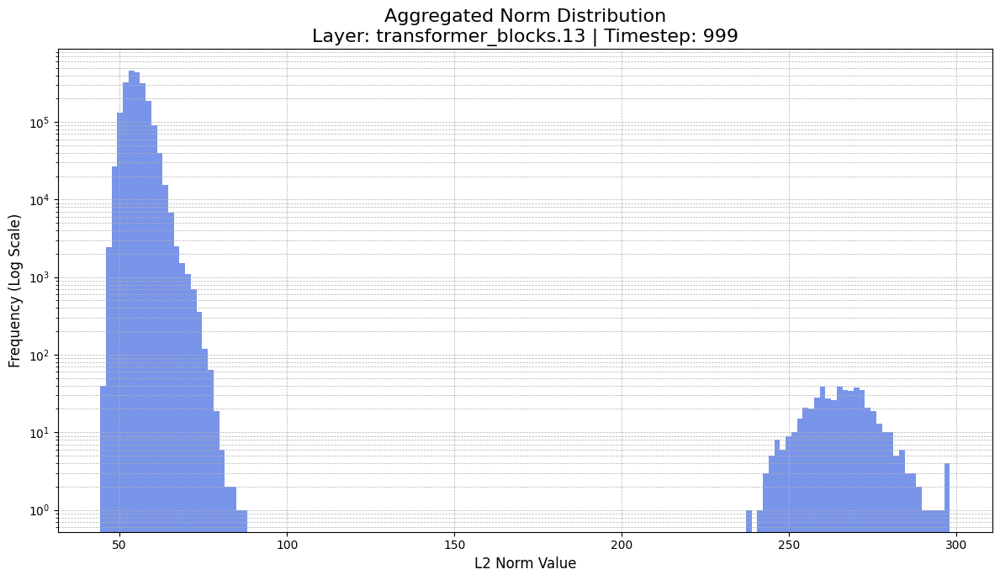

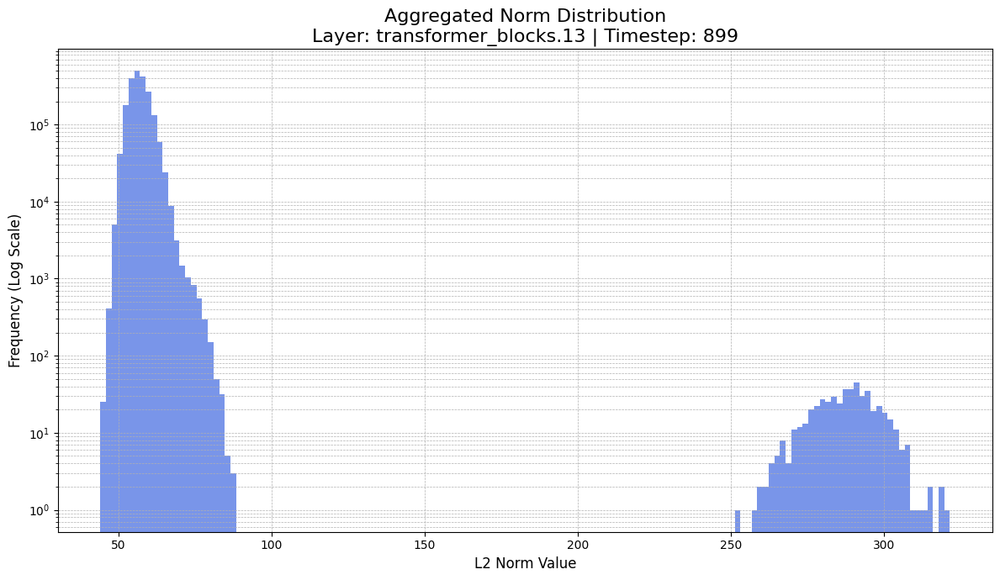

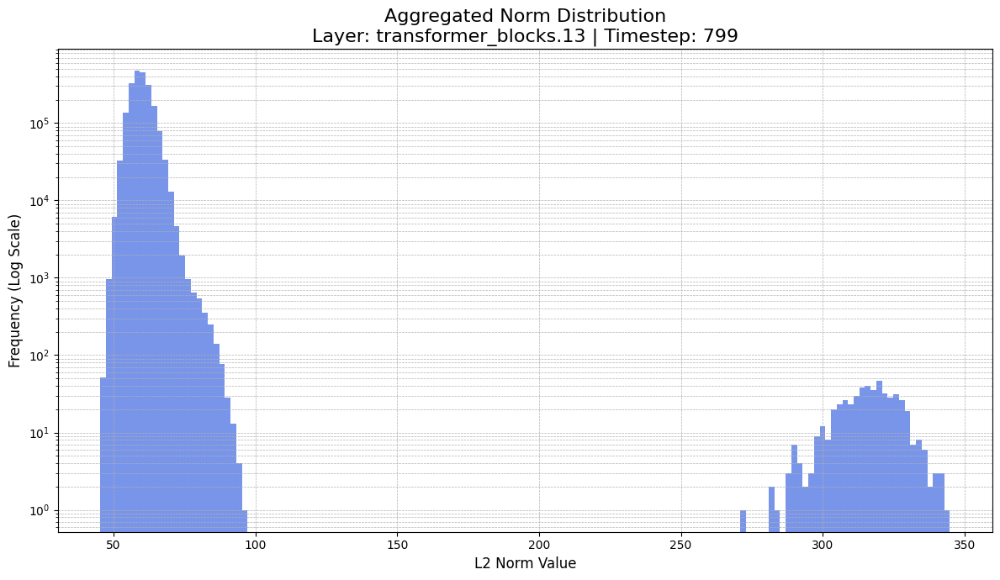

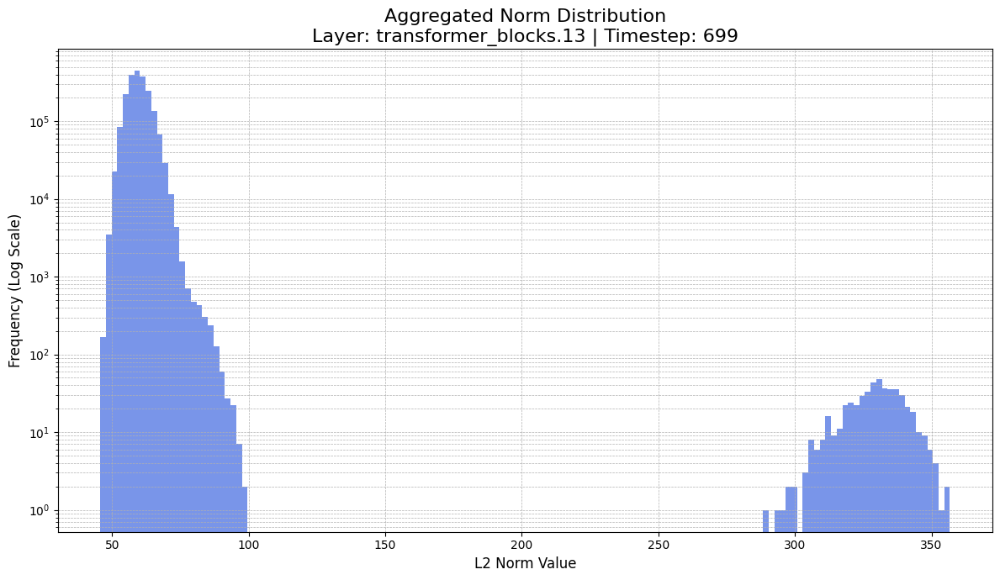

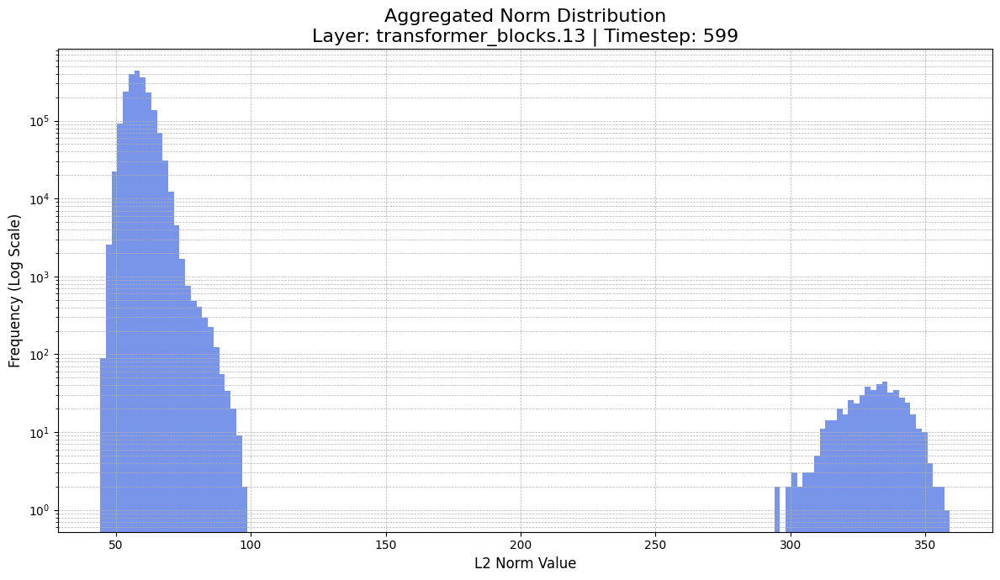

...

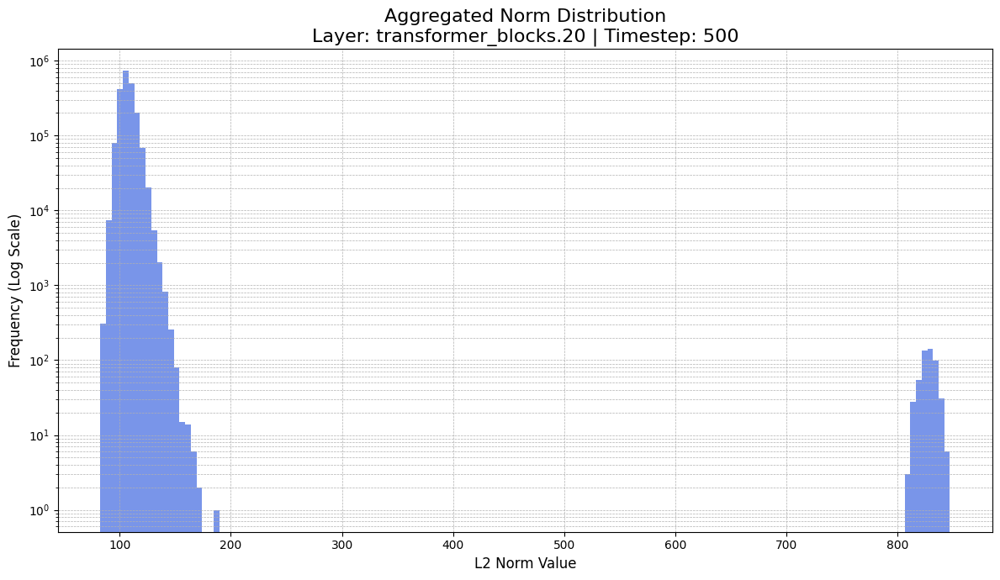

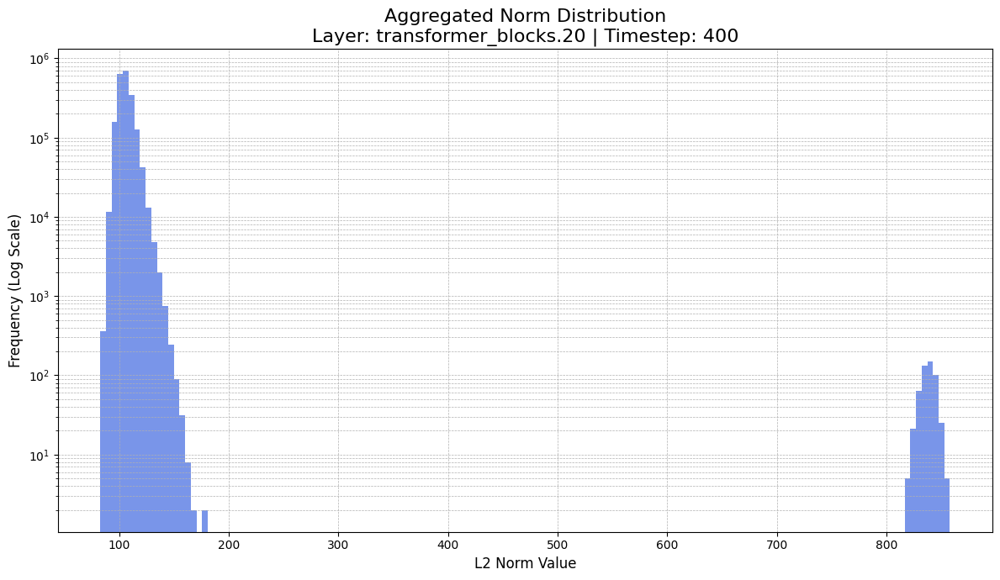

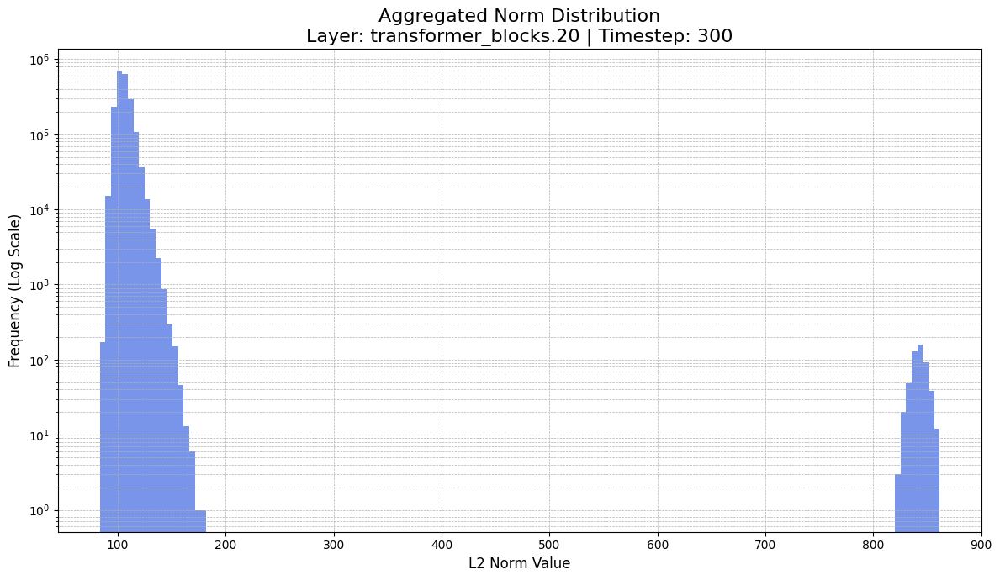

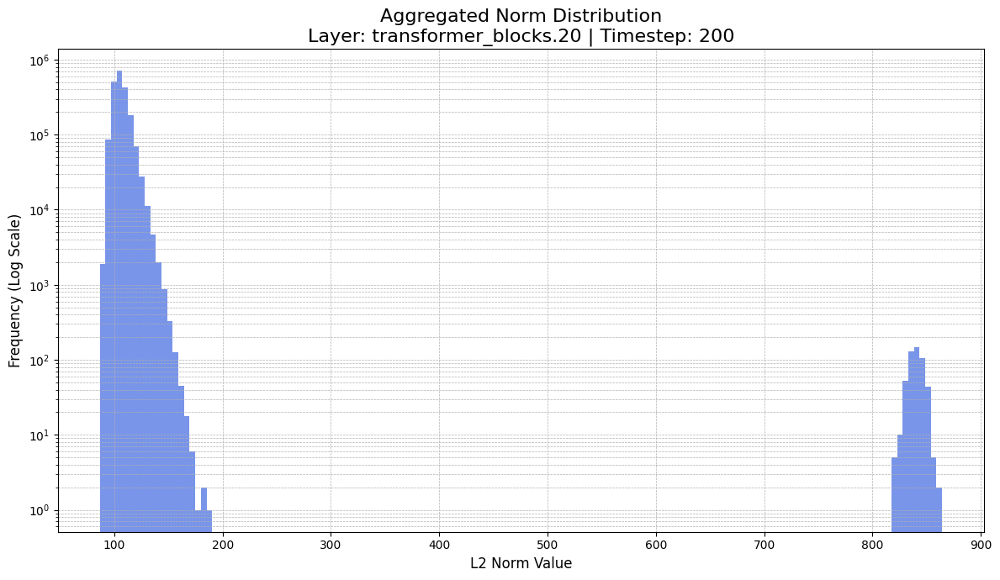

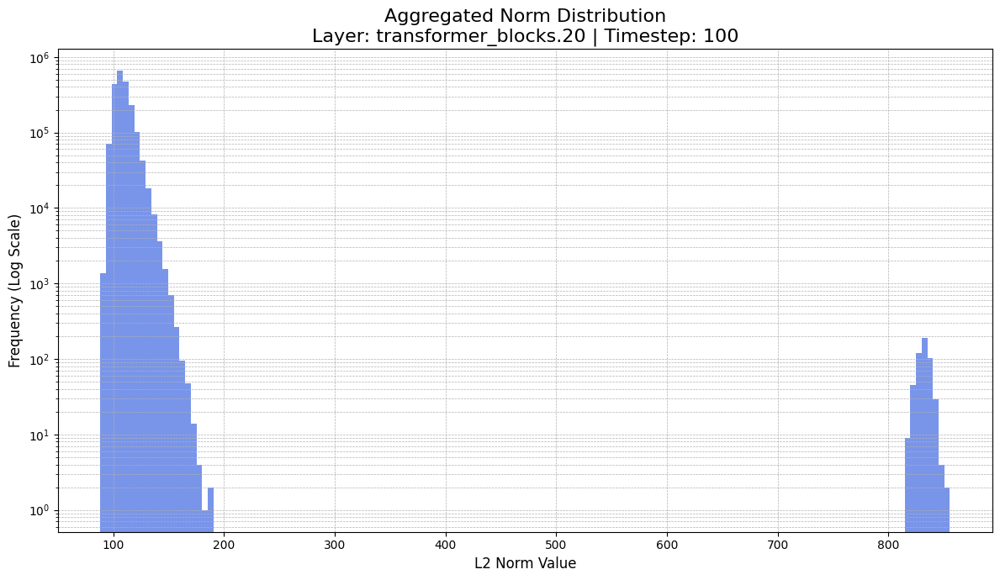

In [ ]:
import h5py
import numpy as np
import matplotlib.pyplot as plt
from tqdm.auto import tqdm

def plot_norms_from_h5(h5_path: str):
    """
    Quickly generates histograms for each (layer, timestep) by reading
    pre-calculated norms from a consolidated HDF5 file.
    """
    print(f"Loading norms from '{h5_path}' and generating plots...")

    try:
        with h5py.File(h5_path, 'r') as hf:
            # Get a sorted list of layers from the HDF5 file
            sorted_layer_names = sorted(hf.keys(), key=lambda name: int(name.split('.')[-1]))

            # Use tqdm to show progress for the outer loop
            for layer_name in tqdm(sorted_layer_names, desc="Processing Layers"):
                sorted_timesteps = sorted(hf[layer_name].keys(), key=int, reverse=True)

                for timestep_str in sorted_timesteps:
                    # Load the aggregated norms for this condition directly into a NumPy array
                    # This is very fast as it's reading from a single, optimized file
                    norms_np = hf[layer_name][timestep_str][:]

                    # --- Create the plot ---
                    plt.figure(figsize=(12, 7))
                    plt.hist(norms_np, bins=150, color='royalblue', alpha=0.7)

                    # Use a log scale for the y-axis to better see the distribution's tails
                    plt.yscale('log')

                    plt.title(f"Aggregated Norm Distribution\nLayer: {layer_name} | Timestep: {timestep_str}", fontsize=16)
                    plt.xlabel("L2 Norm Value", fontsize=12)
                    plt.ylabel("Frequency (Log Scale)", fontsize=12)
                    plt.grid(True, which='both', linestyle='--', linewidth=0.5)
                    plt.tight_layout()
                    plt.show()

    except FileNotFoundError:
        print(f"ERROR: The file '{h5_path}' was not found. Please ensure you have run the previous script to create it.")
    except Exception as e:
        print(f"An error occurred: {e}")

# --- How to Run ---
if __name__ == '__main__':
    h5_file_path = "/content/drive/MyDrive/Algoverse/Linear_Probe_Data/all_norms.h5"

    plot_norms_from_h5(h5_file_path)

Loading norms from '/content/drive/MyDrive/Algoverse/Linear_Probe_Data/all_norms.h5' and generating grid plot...


Plotting Layers:   0%|          | 0/8 [00:00<?, ?it/s]

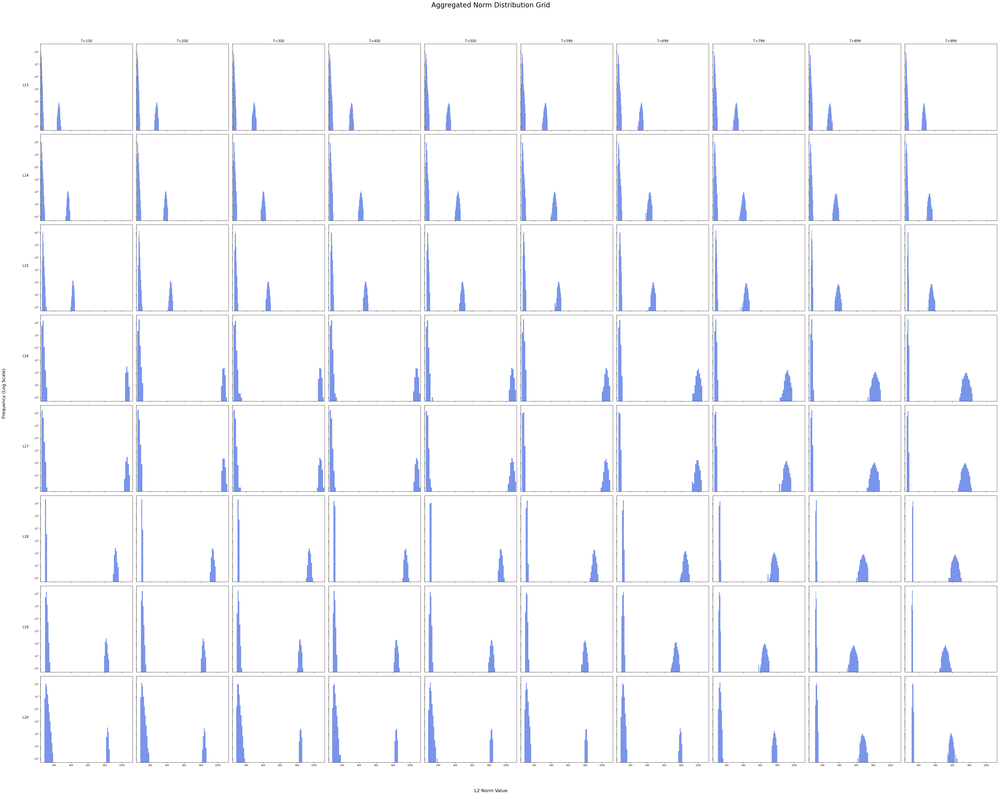

In [ ]:
import h5py
import numpy as np
import matplotlib.pyplot as plt
from tqdm.auto import tqdm

def plot_norm_grid(h5_path: str):
    """
    Generates a single grid figure containing a histogram of L2 norms for each
    (layer, timestep) combination.

    Args:
        h5_path (str): The path to the consolidated HDF5 file of norms.
    """
    print(f"Loading norms from '{h5_path}' and generating grid plot...")

    try:
        with h5py.File(h5_path, 'r') as hf:
            # --- 1. Setup the Grid Structure ---
            sorted_layer_names = sorted(hf.keys(), key=lambda name: int(name.split('.')[-1]))
            # Sort timesteps numerically for column order
            sorted_timesteps = sorted(hf[sorted_layer_names[0]].keys(), key=int)

            nrows = len(sorted_layer_names)
            ncols = len(sorted_timesteps)

            # Create an 8x10 grid of subplots. sharex/sharey are crucial for comparison.
            fig, axes = plt.subplots(
                nrows=nrows,
                ncols=ncols,
                figsize=(50, 40),
                sharex=True,
                sharey=True
            )
            fig.suptitle('Aggregated Norm Distribution Grid', fontsize=24)

            # --- 2. Find Global Range for Consistent Axis Limits ---
            # This ensures all histograms are plotted on the same scale.
            global_min = np.inf
            global_max = -np.inf
            for layer_name in sorted_layer_names:
                for timestep_str in sorted_timesteps:
                    norms_np = hf[layer_name][timestep_str][:]
                    if norms_np.size > 0:
                        global_min = min(global_min, norms_np.min())
                        global_max = max(global_max, norms_np.max())

            # --- 3. Loop Through and Plot on Each Subplot ---
            for row, layer_name in enumerate(tqdm(sorted_layer_names, desc="Plotting Layers")):
                for col, timestep_str in enumerate(sorted_timesteps):
                    ax = axes[row, col]

                    # Load the data for this specific subplot
                    norms_np = hf[layer_name][timestep_str][:]

                    if norms_np.size > 0:
                        ax.hist(norms_np, bins=75, color='royalblue', alpha=0.7, log=True)

                    # --- 4. Clean up Labels to Avoid Clutter ---
                    # Only add titles to the top row
                    if row == 0:
                        ax.set_title(f"T={timestep_str}", fontsize=12)

                    # Only add y-axis labels to the first column
                    if col == 0:
                        layer_index = layer_name.split('.')[-1]
                        ax.set_ylabel(f"L{layer_index}", fontsize=12, rotation=0, labelpad=20, ha='right')

                    # Remove individual tick labels from inner plots
                    ax.tick_params(axis='x', labelsize=8)
                    ax.tick_params(axis='y', labelsize=8)

            # Set shared axis limits
            ax.set_xlim(global_min, global_max)

            # Add shared, figure-level labels
            fig.supxlabel('L2 Norm Value', fontsize=16)
            fig.supylabel('Frequency (Log Scale)', fontsize=16)

            # Adjust layout and display the plot
            plt.tight_layout(rect=[0.03, 0.03, 1, 0.95]) # Adjust for suptitle
            plt.show()

    except FileNotFoundError:
        print(f"ERROR: The file '{h5_path}' was not found.")
    except Exception as e:
        print(f"An error occurred: {e}")

# --- How to Run ---
if __name__ == '__main__':
    h5_file_path = "/content/drive/MyDrive/Algoverse/Linear_Probe_Data/all_norms.h5"

    plot_norm_grid(h5_file_path)

Loading norms from '/content/drive/MyDrive/Algoverse/Linear_Probe_Data/all_norms.h5' and generating layer-wise plots...


Generating Figures for Each Layer:   0%|          | 0/8 [00:00<?, ?it/s]

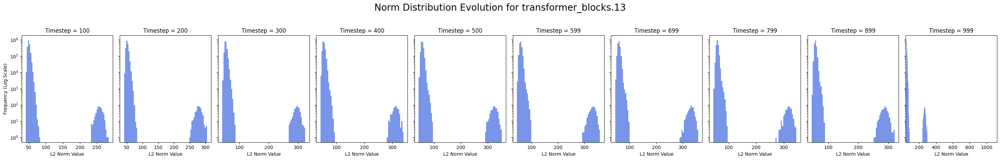

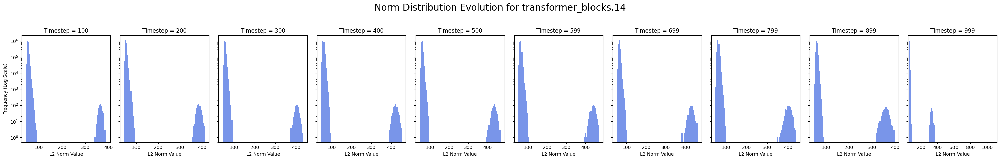

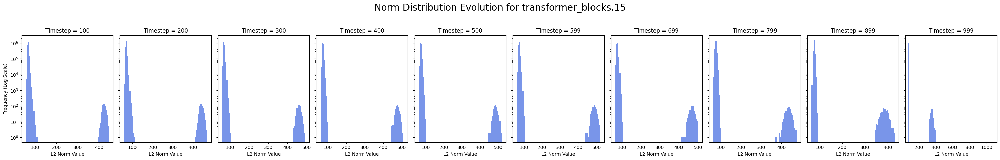

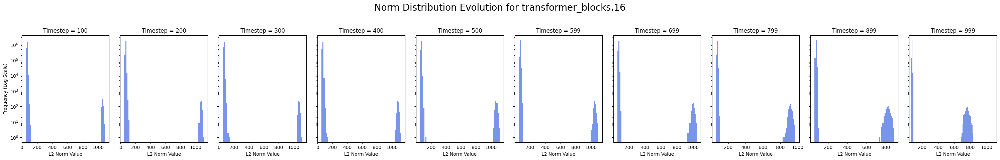

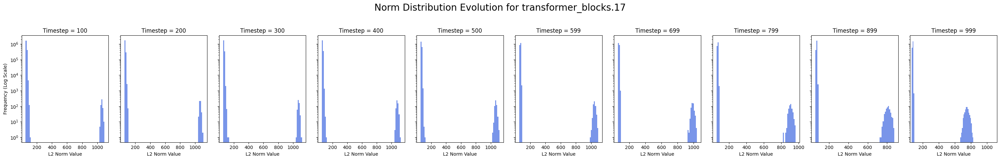

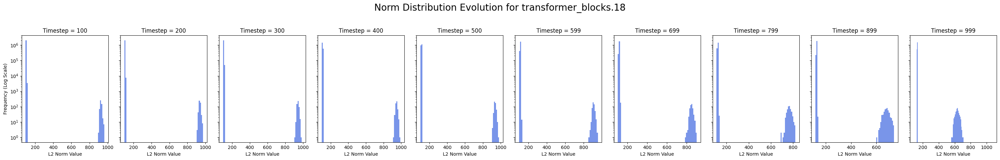

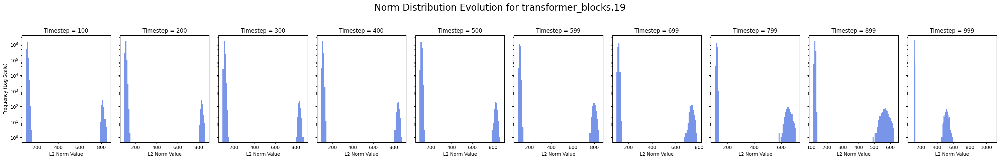

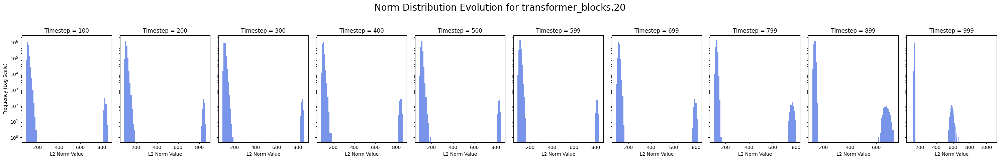

In [ ]:
import h5py
import numpy as np
import matplotlib.pyplot as plt
from tqdm.auto import tqdm

def plot_layer_evolution_grids(h5_path: str):
    """
    Generates a separate figure for each layer, with a grid of histograms
    showing the norm distribution evolution across all timesteps.

    Args:
        h5_path (str): The path to the consolidated HDF5 file of norms.
    """
    print(f"Loading norms from '{h5_path}' and generating layer-wise plots...")

    try:
        with h5py.File(h5_path, 'r') as hf:
            # --- 1. Find the global range of norms for consistent X-axis limits ---
            global_min = np.inf
            global_max = -np.inf
            for layer_name in hf.keys():
                for timestep_str in hf[layer_name].keys():
                    norms_np = hf[layer_name][timestep_str][:]
                    if norms_np.size > 0:
                        global_min = min(global_min, norms_np.min())
                        global_max = max(global_max, norms_np.max())

            # --- 2. Loop through each layer to create a separate figure ---
            sorted_layer_names = sorted(hf.keys(), key=lambda name: int(name.split('.')[-1]))

            for layer_name in tqdm(sorted_layer_names, desc="Generating Figures for Each Layer"):
                sorted_timesteps = sorted(hf[layer_name].keys(), key=int)
                ncols = len(sorted_timesteps)

                # Create a new figure for this layer (1 row, 10 columns)
                fig, axes = plt.subplots(
                    nrows=1,
                    ncols=ncols,
                    figsize=(30, 5),  # Very wide figure to make plots larger
                    sharey=True       # Share y-axis for direct comparison
                )

                # Add a main title for the entire figure (the layer)
                fig.suptitle(f'Norm Distribution Evolution for {layer_name}', fontsize=20)

                # --- 3. Loop through timesteps to create each subplot ---
                for col, timestep_str in enumerate(sorted_timesteps):
                    ax = axes[col]
                    norms_np = hf[layer_name][timestep_str][:]

                    if norms_np.size > 0:
                        ax.hist(norms_np, bins=75, color='royalblue', alpha=0.7, log=True)

                    # --- 4. Add individual labels to each subplot ---
                    ax.set_title(f'Timestep = {timestep_str}')
                    ax.set_xlabel('L2 Norm Value')

                    # Only label the y-axis on the very first plot to avoid clutter
                    if col == 0:
                        ax.set_ylabel('Frequency (Log Scale)')

                # Set the consistent x-axis limit for all plots in this figure
                plt.xlim(global_min, global_max)
                plt.tight_layout(rect=[0, 0.03, 1, 0.95]) # Adjust for suptitle
                plt.show()

    except FileNotFoundError:
        print(f"ERROR: The file '{h5_path}' was not found.")
    except Exception as e:
        print(f"An error occurred: {e}")

# --- How to Run ---
if __name__ == '__main__':
    h5_file_path = "/content/drive/MyDrive/Algoverse/Linear_Probe_Data/all_norms.h5"

    plot_layer_evolution_grids(h5_file_path)

Loading norms from '/content/drive/MyDrive/Algoverse/Linear_Probe_Data/all_norms.h5' and generating a large grid plot...


Plotting Grid:   0%|          | 0/8 [00:00<?, ?it/s]

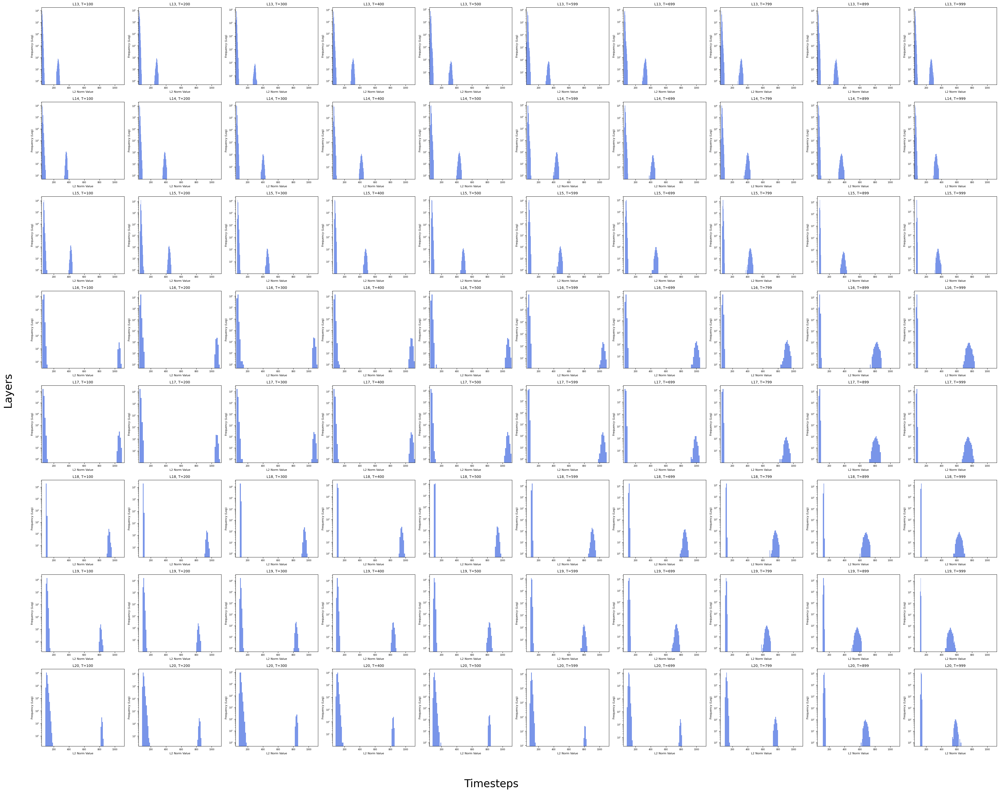

In [ ]:
import h5py
import numpy as np
import matplotlib.pyplot as plt
from tqdm.auto import tqdm

def plot_large_detailed_grid(h5_path: str):
    """
    Generates a single, very large grid figure containing a detailed histogram
    for each (layer, timestep) combination.

    Args:
        h5_path (str): The path to the consolidated HDF5 file of norms.
    """
    print(f"Loading norms from '{h5_path}' and generating a large grid plot...")

    try:
        with h5py.File(h5_path, 'r') as hf:
            # --- 1. Setup the Grid Structure ---
            sorted_layer_names = sorted(hf.keys(), key=lambda name: int(name.split('.')[-1]))
            sorted_timesteps = sorted(hf[sorted_layer_names[0]].keys(), key=int)

            nrows = len(sorted_layer_names)
            ncols = len(sorted_timesteps)

            # Create a very large figure to make each subplot bigger.
            # We remove sharex and sharey to allow for individual labels.
            fig, axes = plt.subplots(
                nrows=nrows,
                ncols=ncols,
                figsize=(40, 32) # Significantly increased figure size
            )

            # --- 2. Find Global Range for Consistent Axis Limits ---
            global_min, global_max = np.inf, -np.inf
            for layer_name in sorted_layer_names:
                for timestep_str in sorted_timesteps:
                    norms_np = hf[layer_name][timestep_str][:]
                    if norms_np.size > 0:
                        global_min = min(global_min, norms_np.min())
                        global_max = max(global_max, norms_np.max())

            # --- 3. Loop Through and Plot on Each Subplot ---
            for row, layer_name in enumerate(tqdm(sorted_layer_names, desc="Plotting Grid")):
                for col, timestep_str in enumerate(sorted_timesteps):
                    ax = axes[row, col]

                    norms_np = hf[layer_name][timestep_str][:]

                    if norms_np.size > 0:
                        ax.hist(norms_np, bins=75, color='royalblue', alpha=0.7, log=True)

                    # --- 4. Add Individual Labels to Each Subplot ---
                    layer_index = layer_name.split('.')[-1]
                    ax.set_title(f'L{layer_index}, T={timestep_str}', fontsize=10)
                    ax.set_xlabel('L2 Norm Value', fontsize=8)
                    ax.set_ylabel('Frequency (Log)', fontsize=8)

                    # Adjust tick label sizes
                    ax.tick_params(axis='x', labelsize=6)
                    ax.tick_params(axis='y', labelsize=6)
                    ax.set_xlim(global_min, global_max) # Apply consistent x-limit

            # --- 5. Add Overall Figure Labels ---
            fig.supylabel('Layers', fontsize=30)
            fig.supxlabel('Timesteps', fontsize=30)

            # Use tight_layout to try and fit all the labels without overlapping
            plt.tight_layout(rect=[0.03, 0.03, 1, 0.98])
            plt.show()

    except FileNotFoundError:
        print(f"ERROR: The file '{h5_path}' was not found.")
    except Exception as e:
        print(f"An error occurred: {e}")

# --- How to Run ---
if __name__ == '__main__':
    h5_file_path = "/content/drive/MyDrive/Algoverse/Linear_Probe_Data/all_norms.h5"

    plot_large_detailed_grid(h5_file_path)

Loading norms from '/content/drive/MyDrive/Algoverse/Linear_Probe_Data/all_norms.h5' and generating layer-wise plots...


Generating Figures for Each Layer:   0%|          | 0/8 [00:00<?, ?it/s]

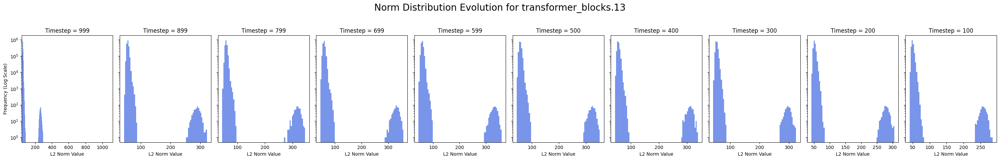

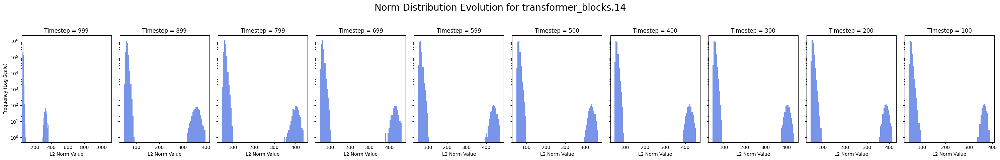

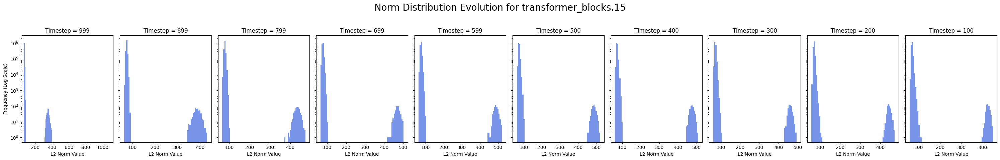

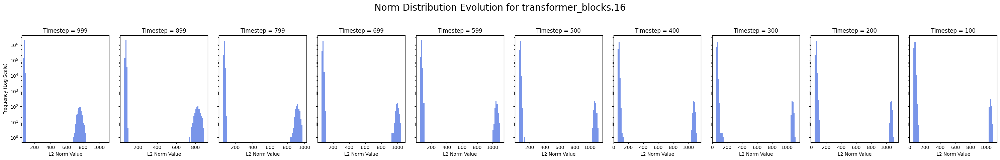

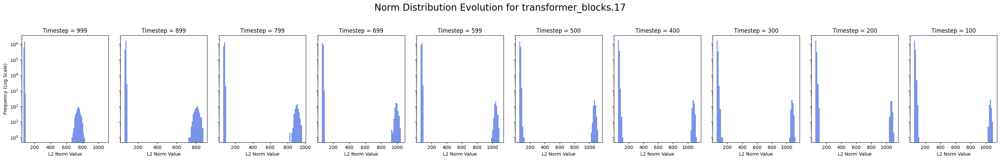

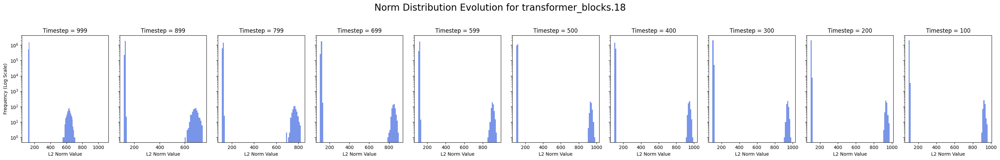

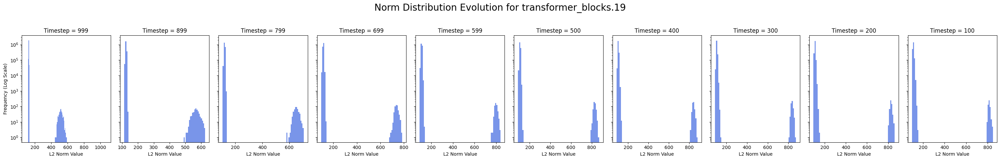

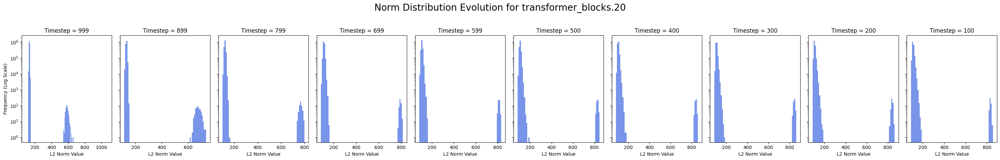

In [ ]:
import h5py
import numpy as np
import matplotlib.pyplot as plt
from tqdm.auto import tqdm

def plot_layer_evolution_grids(h5_path: str):
    """
    Generates a separate figure for each layer, with a grid of histograms
    showing the norm distribution evolution across all timesteps in denoising order.
    """
    print(f"Loading norms from '{h5_path}' and generating layer-wise plots...")

    try:
        with h5py.File(h5_path, 'r') as hf:
            global_min = np.inf
            global_max = -np.inf
            for layer_name in hf.keys():
                for timestep_str in hf[layer_name].keys():
                    norms_np = hf[layer_name][timestep_str][:]
                    if norms_np.size > 0:
                        global_min = min(global_min, norms_np.min())
                        global_max = max(global_max, norms_np.max())

            sorted_layer_names = sorted(hf.keys(), key=lambda name: int(name.split('.')[-1]))

            for layer_name in tqdm(sorted_layer_names, desc="Generating Figures for Each Layer"):
                # FIX: Sort timesteps in descending (reverse) order to show denoising
                sorted_timesteps = sorted(hf[layer_name].keys(), key=int, reverse=True)
                ncols = len(sorted_timesteps)

                fig, axes = plt.subplots(
                    nrows=1,
                    ncols=ncols,
                    figsize=(30, 5),
                    sharey=True
                )

                fig.suptitle(f'Norm Distribution Evolution for {layer_name}', fontsize=20)

                for col, timestep_str in enumerate(sorted_timesteps):
                    ax = axes[col]
                    norms_np = hf[layer_name][timestep_str][:]

                    if norms_np.size > 0:
                        ax.hist(norms_np, bins=75, color='royalblue', alpha=0.7, log=True)

                    ax.set_title(f'Timestep = {timestep_str}')
                    ax.set_xlabel('L2 Norm Value')

                    if col == 0:
                        ax.set_ylabel('Frequency (Log Scale)')

                # Use ax.set_xlim() on a specific subplot axis
                axes[0].set_xlim(global_min, global_max)
                plt.tight_layout(rect=[0, 0.03, 1, 0.95])
                plt.show()

    except FileNotFoundError:
        print(f"ERROR: The file '{h5_path}' was not found.")
    except Exception as e:
        print(f"An error occurred: {e}")

# --- How to Run ---
if __name__ == '__main__':
    h5_file_path = "/content/drive/MyDrive/Algoverse/Linear_Probe_Data/all_norms.h5"

    plot_layer_evolution_grids(h5_file_path)

Loading norms from '/content/drive/MyDrive/Algoverse/Linear_Probe_Data/all_norms.h5' and generating the master grid plot...


Plotting Master Grid:   0%|          | 0/8 [00:00<?, ?it/s]

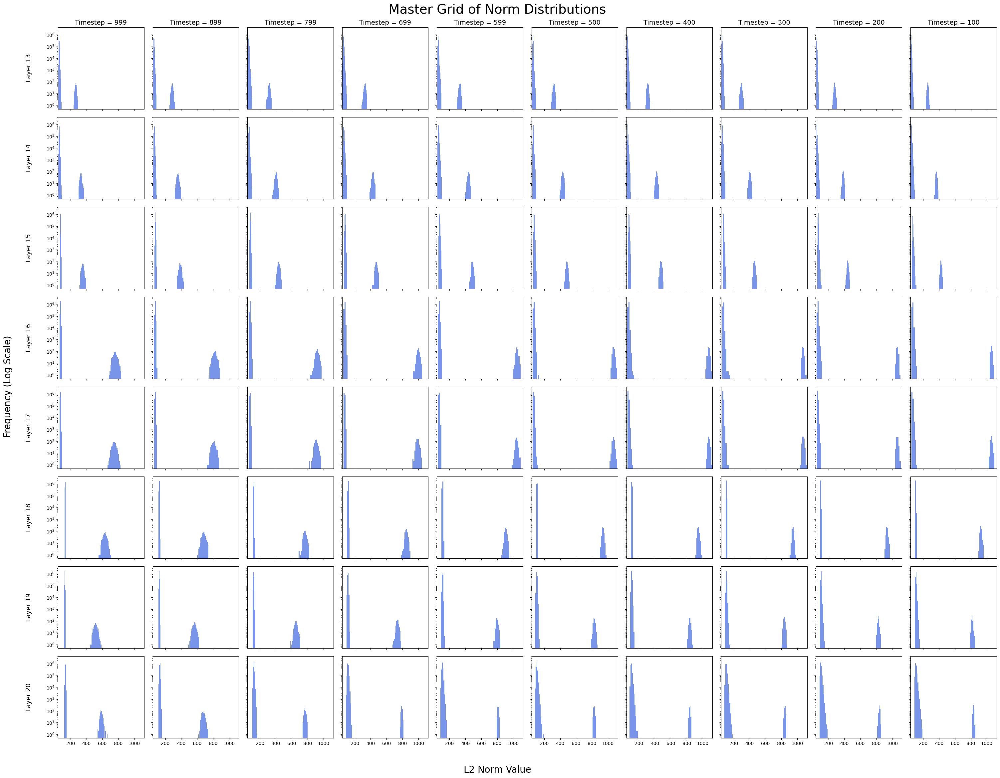

In [ ]:
import h5py
import numpy as np
import matplotlib.pyplot as plt
from tqdm.auto import tqdm

def plot_master_grid(h5_path: str):
    """
    Generates a single, tall master grid image with all 80 histograms,
    stacking the layer-evolution plots vertically.

    Args:
        h5_path (str): The path to the consolidated HDF5 file of norms.
    """
    print(f"Loading norms from '{h5_path}' and generating the master grid plot...")

    try:
        with h5py.File(h5_path, 'r') as hf:
            # --- 1. Setup the Grid Structure ---
            sorted_layer_names = sorted(hf.keys(), key=lambda name: int(name.split('.')[-1]))
            sorted_timesteps = sorted(hf[sorted_layer_names[0]].keys(), key=int, reverse=True) # Denoising order

            nrows = len(sorted_layer_names)
            ncols = len(sorted_timesteps)

            # Create a tall 8x10 grid of subplots
            fig, axes = plt.subplots(
                nrows=nrows,
                ncols=ncols,
                figsize=(30, 24), # Tall and wide figure
                sharex=True,
                sharey=True
            )
            fig.suptitle('Master Grid of Norm Distributions', fontsize=28)

            # --- 2. Find Global Range for Consistent Axis Limits ---
            global_min, global_max = np.inf, -np.inf
            for layer_name in sorted_layer_names:
                for timestep_str in sorted_timesteps:
                    norms_np = hf[layer_name][timestep_str][:]
                    if norms_np.size > 0:
                        global_min = min(global_min, norms_np.min())
                        global_max = max(global_max, norms_np.max())

            # --- 3. Loop Through and Plot on Each Subplot ---
            for row, layer_name in enumerate(tqdm(sorted_layer_names, desc="Plotting Master Grid")):
                for col, timestep_str in enumerate(sorted_timesteps):
                    ax = axes[row, col]
                    norms_np = hf[layer_name][timestep_str][:]

                    if norms_np.size > 0:
                        ax.hist(norms_np, bins=75, color='royalblue', alpha=0.7, log=True)

                    # --- 4. Label the Grid's Edges ---
                    # Add Timestep title only to the top row
                    if row == 0:
                        ax.set_title(f"Timestep = {timestep_str}", fontsize=14)

                    # Add Layer label only to the first column
                    if col == 0:
                        layer_index = layer_name.split('.')[-1]
                        # Use a text object for better placement than ylabel
                        ax.text(-0.3, 0.5, f"Layer {layer_index}", transform=ax.transAxes,
                                fontsize=14, va='center', ha='right', rotation=90)

                    # Only show tick labels on the bottom and left edges
                    ax.tick_params(labelbottom=(row == nrows - 1), labelleft=(col == 0))

            # Set shared axis limits for all subplots
            axes[0, 0].set_xlim(global_min, global_max)

            # --- 5. Add Shared, Figure-level Labels ---
            fig.text(0.5, 0.02, 'L2 Norm Value', ha='center', va='center', fontsize=20)
            fig.text(0.01, 0.5, 'Frequency (Log Scale)', ha='center', va='center', rotation='vertical', fontsize=20)

            # Adjust subplot spacing to make room for the shared labels and titles
            plt.subplots_adjust(left=0.06, bottom=0.06, right=1, top=0.95, wspace=0.1, hspace=0.1)
            plt.show()

    except FileNotFoundError:
        print(f"ERROR: The file '{h5_path}' was not found.")
    except Exception as e:
        print(f"An error occurred: {e}")

# --- How to Run ---
if __name__ == '__main__':
    h5_file_path = "/content/drive/MyDrive/Algoverse/Linear_Probe_Data/all_norms.h5"

    plot_master_grid(h5_file_path)

In [ ]:
from google.colab import runtime
runtime.unassign()